# Lab 2: Image Segmentation, Filter, Feature points

This week you learned about manipulating image color from the pixel values and histogram. In this session you will get some more experience coding image segmentation algorithms and filtering with pixel location information too. 

There are four parts and you should aim to finish first two parts in the lab sesion on Tuesday.

There are one task each for Part 1 and 2 and 4. Please complete them and submit them with the finished jupyter note book.

# Part 1 Segmentation

Your task will be to code a simple statistical method that uses Region growing or connected components.

## Task 1 K-means Segmentation


In previsou task you have oeprated over all pixels in the image for computing histogram. In this session you will get some experience coding image segmentation algorithms. Your task will be to code a simple statistical method that uses k-means clustering on all pixels.

K-means clustering is a well-known approach for separating data (often of high dimensionality) into
different groups depending on their distance. In the case of images this is a useful method for
segmenting an image into regions, provided that the number of regions (k) is known in advance. It is
based on the fact that pixels belonging to the same region will most likely have similar intensities. 

The algorithm is:

a) Given the number of clusters, k, initialise their centres to some values.

b) Go over the pixels in the image and assign each one to its closest cluster according to its distance to the centre of the cluster.

c) Update the cluster centres to be the average of the pixels added.

d) Repeat steps b and c until the cluster centres do not get updated anymore.

In [1]:
from numpy.ma.core import arctan
# %matplotlib inline is a magic function for displaying the image in the notebook
%matplotlib inline
import numpy as np
import cv2
import copy
import matplotlib.image as mpimg
from matplotlib import pyplot as plt



### Task 1.1 Use the k-means function in sklearn and see results

First, you can use the built-in kmeans function in sklearn and see the results. 
You can figure out how to this from the specification: https://scikit-learn.org/stable/modules/generated/sklearn.cluster.KMeans.html

### Load image

Important Note: Don't forget to convert the image to float representation.

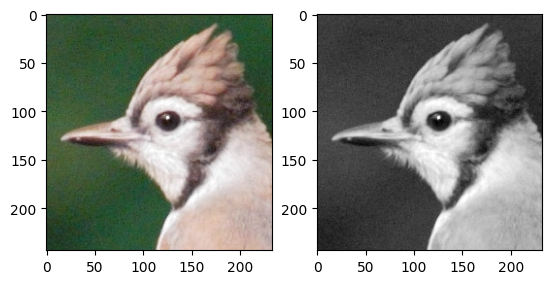

In [2]:
# Load image and conver to float representation
raw_img = cv2.imread("../dataset/sample_image.jpg")
raw_gray_img = cv2.cvtColor(raw_img, cv2.COLOR_BGR2GRAY)
img = raw_img.astype(np.float32) / 255.
gray_img = raw_gray_img.astype(np.float32) / 255.
plt.subplot(1, 2, 1)
plt.imshow(img)
plt.subplot(1, 2, 2)
plt.imshow(gray_img, "gray")

### Results on Gray-scale Image

[[0.7622416]
 [0.2894613]]


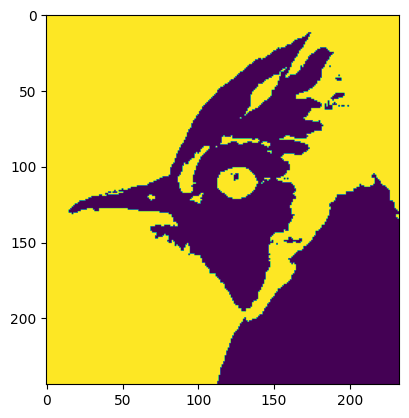

In [3]:
from sklearn.cluster import KMeans
# Flatten the image dimension first
gray_img_flat = gray_img.reshape(-1, 1)
kmeans = KMeans(n_clusters=2, random_state=0).fit(gray_img_flat)

H, W = gray_img.shape
# Unflatten back
labels = kmeans.labels_.reshape(H, W)
plt.imshow(labels)
print(kmeans.cluster_centers_)

[[0.82246774 0.7527642  0.728614  ]
 [0.23835205 0.3262207  0.2215638 ]]


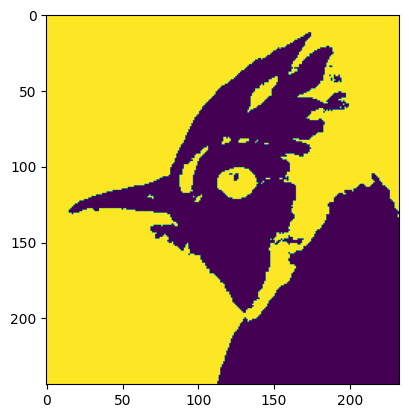

In [4]:
### Results on RGB image
img_flat = img.reshape(-1, 3)
kmeans = KMeans(n_clusters=2, random_state=0).fit(img_flat)

H, W, _ = img.shape
# Unflatten back
labels = kmeans.labels_.reshape(H, W)
plt.imshow(labels)
print(kmeans.cluster_centers_)

### Task 1.2 Implement your own k-means

Now you need to implement your own k-means function. Use your function on different greyscale images and try comparing the results to the results you get from sklearn kmeans function.

### Implement your own functions here:

In [5]:
def my_kmeans(I, k):
    """
    Parameters
    ----------
    I: the image to be segmented (greyscale to begin with) H by W array
    k: the number of clusters (use a simple image with k=2 to begin with)

    Returns
    ----------
    clusters: a vector that contains the final cluster centres
    L: an array the same size as the input image that contains the label for each of the image pixels, according to which cluster it belongs
    """

    assert len(I.shape) == 2, "Wrong input dimensions! Please make sure you are using a gray-scale image!"
    # Write your code here:
    flattened_image = I.flatten()
    
    clusters = np.random.choice(flattened_image, k, replace=False)
    # Initialize labels
    L = np.zeros_like(flattened_image, dtype=np.int32)
    
    variances = []
    for _ in range(1000):
        # Step 1: Assign each pixel to the nearest cluster center
        distances = np.abs(flattened_image[:, None] - clusters[None, :])  # Compute absolute differences
        new_L = np.argmin(distances, axis=1)

        variance = sum(np.sum((flattened_image[new_L == i] - clusters[i])**2) for i in range(k))
        variances.append(variance)
        # Step 2: Recalculate cluster centers as the mean of assigned pixels
        new_clusters = np.array([flattened_image[new_L == i].mean() if np.any(new_L == i) else clusters[i] for i in range(k)])

        # Check for convergence
        if np.all(np.abs(new_clusters - clusters) < 1e-4):
            print("Converged")
            break

        clusters = new_clusters
        L = new_L

    # Reshape labels back to the image's dimensions
    L = L.reshape(H, W)
    
    return clusters, L, variances

def my_kmeans_rgb(I, k):
    """
    Parameters
    ----------
    I: the image to be segmented (greyscale to begin with) H by W array
    k: the number of clusters (use a simple image with k=2 to begin with)

    Returns
    ----------
    clusters: a vector that contains the final cluster centres
    L: an array the same size as the input image that contains the label for each of the image pixels, according to which cluster it belongs
    """

    assert len(I.shape) == 3, "Wrong input dimensions! Please make sure you are using a RGB image!"
    # Write your code here:

    flattened_image = I.reshape(-1,3)

    clusters = flattened_image[np.random.choice(flattened_image.shape[0], k, replace=False)]

    # Initialize labels
    L = np.zeros_like(flattened_image, dtype=np.int32)

    variances = []
    for _ in range(1000):
        # Step 1: Assign each pixel to the nearest cluster center
        distances = np.linalg.norm(flattened_image[:, None] - clusters[None, :], axis=2)  # Compute absolute differences
        new_L = np.argmin(distances, axis=1)

        variance = sum(np.sum((flattened_image[new_L == i] - clusters[i])**2) for i in range(k))
        variances.append(variance)

        # Step 2: Recalculate cluster centers as the mean of assigned pixels
        new_clusters = np.array([flattened_image[new_L == i].mean(axis=0) if np.any(new_L == i) else clusters[i] for i in range(k)])

        # Check for convergence
        if np.all(np.linalg.norm(new_clusters - clusters, axis=1) < 1e-4):
            print("Converged")
            break

        clusters = new_clusters
        L = new_L

    # Reshape labels back to the image's dimensions
    L = L.reshape(H, W)

    return clusters, L, variances


### Show results here:

Converged
[0.28945825 0.7622435 ]
380.82086181640625


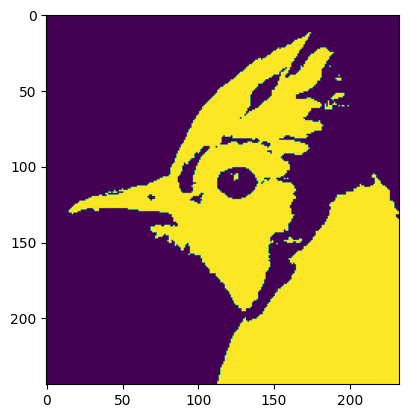

In [6]:
centroids, labels, variances = my_kmeans(gray_img, 2)
print(centroids)
print(variances[-1])
plt.imshow(labels)

### More things to try out:
1. Try different values for k. For k > 2 you will need some way to display the output L (other than simple black and white). Consider using a colour map with the imshow function.
2. Adapt your function so that it will handle colour dataset as well. What changes do you have to make?

Converged
[0.28073347 0.8242718  0.6257318 ]


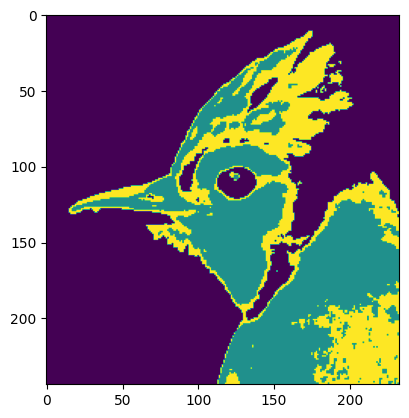

In [7]:
# k=3
centroids, labels, variances = my_kmeans(gray_img, 3)
plt.imshow(labels)
print(centroids)

Converged
[[0.822552   0.75285155 0.72873324]
 [0.23840699 0.32619616 0.22162087]]


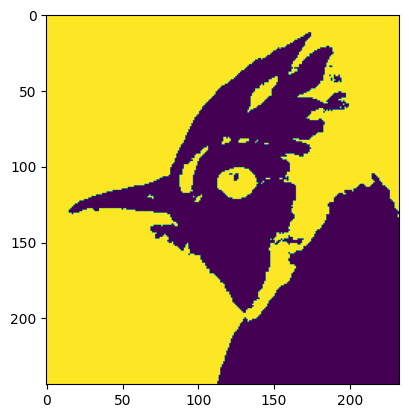

In [8]:
centroids, labels, variances = my_kmeans_rgb(img, 2)
plt.imshow(labels)
print(centroids)

Greyscale Testing

Converged
Converged
Converged
Converged
Converged
Converged
[380.82347106933594, 208.8747100830078, 119.94563293457031, 87.33955383300781, 61.46694850921631, 48.55211639404297]


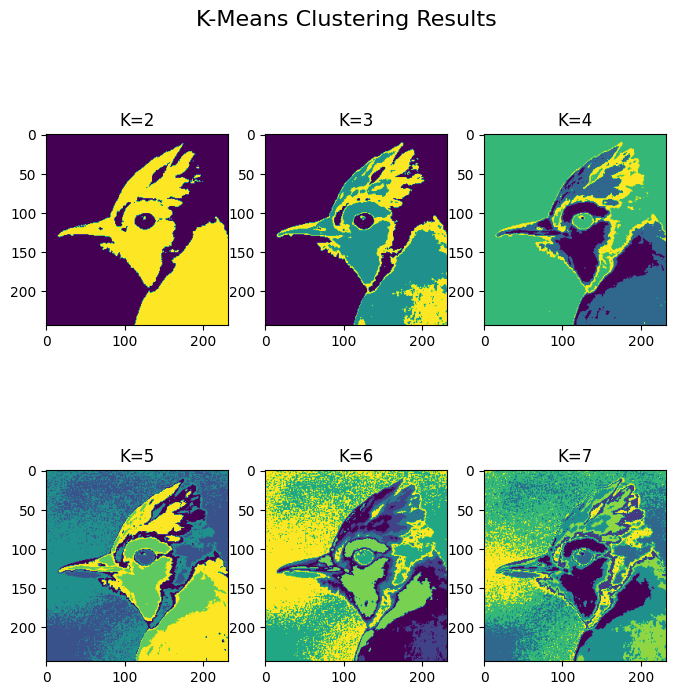

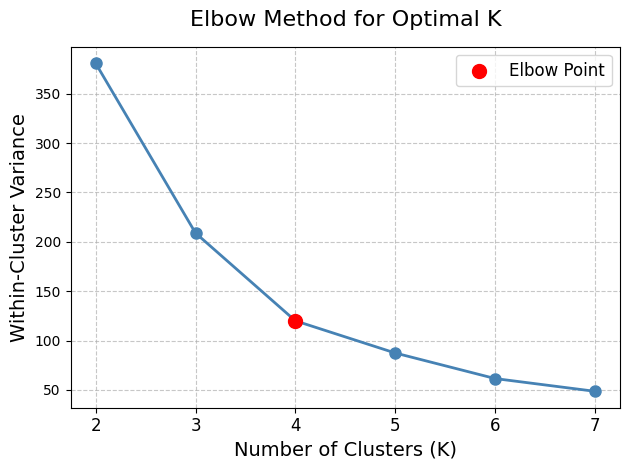

In [12]:
# to visualize the plots within the notebook
%matplotlib inline
# to enable interactive
#%matplotlib ipympl
import matplotlib.image as mpimg
from matplotlib import pyplot as plt
import random
from PIL import Image

imgs = []
final_variances = []
for k in range(1,7):
    centroids, labels, variances = my_kmeans(gray_img, k+1)
    final_variances.append(variances[-1])
    imgs.append(labels)
print(final_variances)

fig, axes = plt.subplots(2,3, figsize=(8,8))
fig.suptitle("K-Means Clustering Results", fontsize=16)
axes[0,0].imshow(imgs[0]) 
axes[0,0].set_title("K=2") 

axes[0,1].imshow(imgs[1])
axes[0,1].set_title("K=3")

axes[0,2].imshow(imgs[2])
axes[0,2].set_title("K=4")

axes[1,0].imshow(imgs[3])
axes[1,0].set_title("K=5")

axes[1,1].imshow(imgs[4])
axes[1,1].set_title("K=6")

axes[1,2].imshow(imgs[5])
axes[1,2].set_title("K=7")
plt.show()

plt.plot(final_variances, marker='o', color='steelblue', linewidth=2, markersize=8)
plt.xticks(ticks=range(len(final_variances)), labels=["2", "3", "4", "5", "6", "7"], fontsize=12)
plt.xlabel("Number of Clusters (K)", fontsize=14)
plt.ylabel("Within-Cluster Variance", fontsize=14)
plt.title("Elbow Method for Optimal K", fontsize=16, pad=15)
plt.grid(True, linestyle='--', alpha=0.7)

# Highlight the elbow point (e.g., index 2, K=4)
elbow_idx = 2
plt.scatter(elbow_idx, final_variances[elbow_idx], color='red', s=100, label="Elbow Point", zorder=2)
plt.legend(fontsize=12)

plt.tight_layout()
plt.show()


RGB Testing

Converged
Converged
Converged
Converged
Converged
Converged
[1400.166015625, 785.63427734375, 489.6099090576172, 368.63660430908203, 291.75218200683594, 234.536958694458]


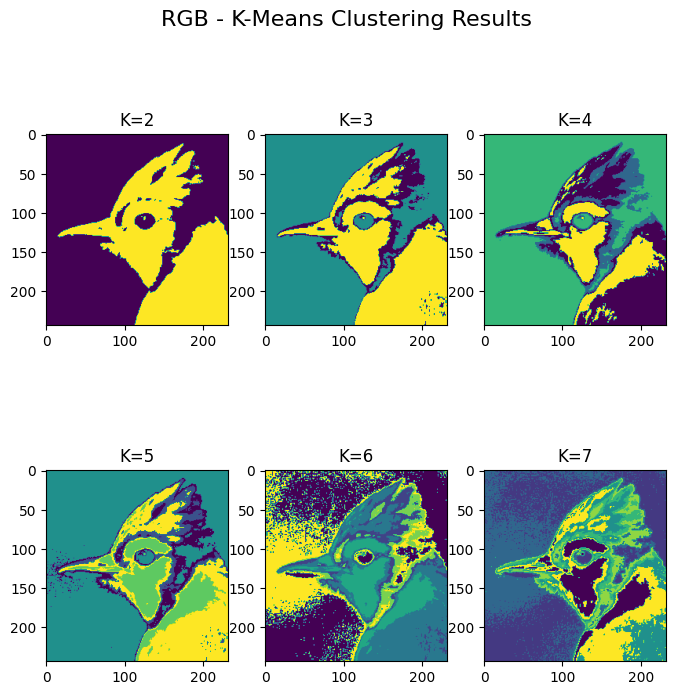

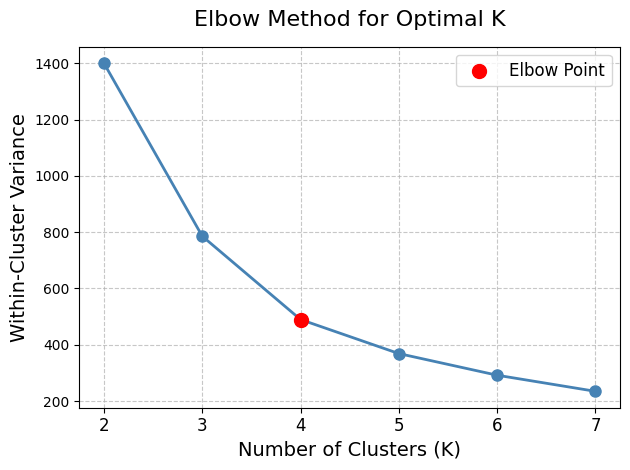

In [14]:
# to visualize the plots within the notebook
%matplotlib inline
# to enable interactive
#%matplotlib ipympl
import matplotlib.image as mpimg
from matplotlib import pyplot as plt
import random
from PIL import Image

imgs = []
final_variances = []
for k in range(1,7):
    centroids, labels, variances = my_kmeans_rgb(img, k+1)
    final_variances.append(variances[-1])
    imgs.append(labels)
print(final_variances)

fig, axes = plt.subplots(2,3, figsize=(8,8))
fig.suptitle("RGB - K-Means Clustering Results", fontsize=16)
axes[0,0].imshow(imgs[0])
axes[0,0].set_title("K=2")

axes[0,1].imshow(imgs[1])
axes[0,1].set_title("K=3")

axes[0,2].imshow(imgs[2])
axes[0,2].set_title("K=4")

axes[1,0].imshow(imgs[3])
axes[1,0].set_title("K=5")

axes[1,1].imshow(imgs[4])
axes[1,1].set_title("K=6")

axes[1,2].imshow(imgs[5])
axes[1,2].set_title("K=7")
plt.show()

plt.plot(final_variances, marker='o', color='steelblue', linewidth=2, markersize=8)
plt.xticks(ticks=range(len(final_variances)), labels=["2", "3", "4", "5", "6", "7"], fontsize=12)
plt.xlabel("Number of Clusters (K)", fontsize=14)
plt.ylabel("Within-Cluster Variance", fontsize=14)
plt.title("Elbow Method for Optimal K", fontsize=16, pad=15)
plt.grid(True, linestyle='--', alpha=0.7)

# Highlight the elbow point (e.g., index 2, K=4)
elbow_idx = 2
plt.scatter(elbow_idx, final_variances[elbow_idx], color='red', s=100, label="Elbow Point", zorder=2)
plt.legend(fontsize=12)

plt.tight_layout()
plt.show()

## Task 2: Region growing
Region growing is a simple way to segment a region of interest from the background of an image.
It takes in a gray-scale image and produces a binary image as output, where a value of 1 represents the region of interest and a value of 0 represents the background.

The algorithm is:
1. Start from a seed pixel.
2. Add neighbouring pixels that satisfy the criteria defining a region (e.g. similar intensity values, intensity above a threshold).
3. Repeat until we can include no more pixels.

Your task is to write a function in Python that implements the region growing algorithm.
Something like:
```
  segmented_img = region_growing(img, x, y)
```

* img: the image to be segmented
* x: the x-coordinate (j if indexed by numpy array) of the seed pixel
* y: the y-coordinate (i if indexed by numpy array) of the seed pixel
* segmented_img: the binary image output of region growing

**Hint:** This is process basically a **Breadth-first Search (BFS)**, which could be easily implemented it with a **queue** (check out collections.deque in PyThon): 

1. Initialise the queue with the seed pixel. 
2. Every time pop the first element from the queue and add its neighbour pixels to the queue if they satisfy the criteria (e.g. intensity above the threshold).
3. Finish when the queue is empty

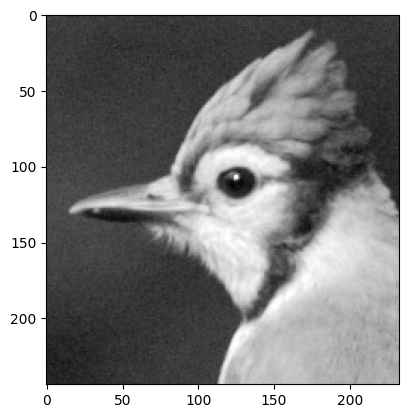

In [22]:
# Load your image
img = cv2.imread('../dataset/sample_image.jpg')
gray_img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY).astype(np.float32)
plt.imshow(gray_img, 'gray')
plt.show()

In [32]:
from collections import deque
def region_growing(img, x, y, thresh=100, connectivity = 8):
    '''
    Impelemnt region growing algorithm to segment a gray scaled image into regions
    :param img: gray scaled image [H, W]
    :param x, y: coordinate of the seed pixel
    :param thresh: region growing threshold
    :return: segmented image [H, W]
    '''
    assert img.ndim == 2, "Expect a gray-scale image!!!"
    # Write your own code here
    segmented_img = np.zeros_like(img, dtype=np.uint8)
    seed_value = img[x,y]
    print(seed_value)
    queue = deque()
    queue.append((x, y))

    visited = np.zeros_like(img, dtype=bool)
    
    if connectivity == 8:
        neighbors = [(-1, 0), (1, 0), (0, -1), (0, 1), (-1, -1), (-1, 1), (1, -1), (1, 1)]
    else:
        neighbors = [(-1, 0), (1, 0), (0, -1), (0, 1)]
    iterations = 0
    while queue:
        cx, cy = queue.popleft()
            # Skip if the pixel is out of bounds or already visited
        if cx < 0 or cy < 0 or cx >= H or cy >= W or visited[cx, cy]:
            continue
    
        # Mark the pixel as visited
        visited[cx, cy] = True
        
        # Check if the pixel should be added to the region
        if abs(int(img[cx,cy]) - int(seed_value)) <= thresh:
            segmented_img[cx,cy] = 255
            # Add similar neighbors to queue
            for dx, dy in neighbors:
                nx, ny = cx + dx, cy + dy
                if 0 <= nx < H and 0 <= ny < W and not visited[nx, ny]:
                    queue.appendleft((nx, ny))

        # if(iterations % 250 == 0):
        #     plt.imshow(segmented_img, 'gray')
        #     plt.savefig(f'Lab2-Figs/region-growing-iteration-{iterations}')
        #     plt.close()

        iterations += 1
    return segmented_img
   


177.0


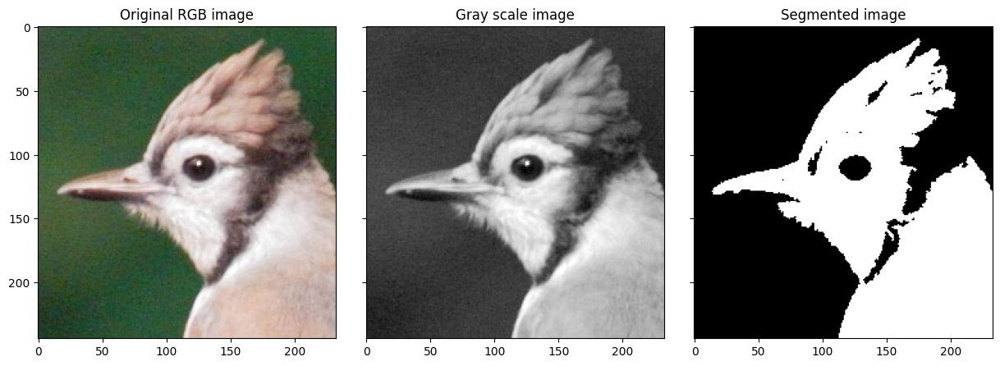

In [51]:
# define set of seed pixel points
x, y = 100, 100

# run region growing algorithm
seg_img = region_growing(gray_img, x, y, thresh=80, connectivity=4)

# Show Original and segmented image
fig, axis = plt.subplots(1, 3, figsize=(15,10), sharey=True)
fig.subplots_adjust(wspace=0.1, hspace=0.05)
axis[0].imshow(img)
axis[0].set_title('Original RGB image')

axis[1].imshow(gray_img, 'gray')
axis[1].set_title('Gray scale image')

axis[2].imshow(seg_img, 'gray')
axis[2].set_title('Segmented image')
plt.show()

### There are two important factors that influence the performance of a region growing algorithm.

#### 1. The first is the seed pixel selection.
Try the following:
1. Pick a random pixel in the image.
2. Plot the histogram of the image, select a reasonable threshold and then search for a pixel whose intensity value is above the threshold (look for the `matplotlib.pyplot.hist()` function).
3. Do it manually (Hint: You can do this by enabling the interactive mode for `matplotlib`).

Which one is better?

(array([[  0.,  51., 181., ...,   0.,   0.,   0.],
        [  1.,  44., 187., ...,   0.,   0.,   0.],
        [  0.,  46., 183., ...,   0.,   0.,   0.],
        ...,
        [  0.,  74.,  50., ...,  56.,   0.,   0.],
        [  0.,  74.,  53., ...,  41.,   0.,   0.],
        [  0.,  86.,  43., ...,  38.,   0.,   0.]]),
 array([ 16.        ,  39.90000153,  63.79999924,  87.69999695,
        111.59999847, 135.5       , 159.3999939 , 183.30000305,
        207.19999695, 231.09999084, 255.        ]),
 <a list of 233 BarContainer objects>)

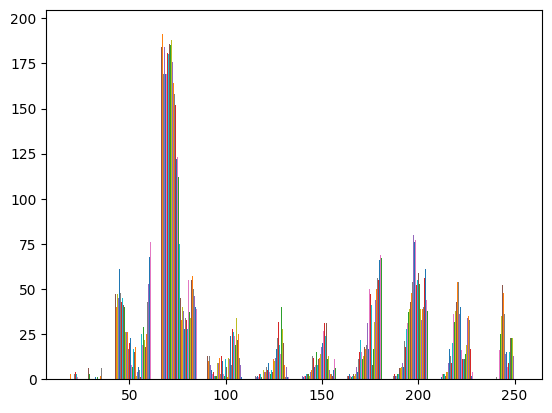

In [10]:
plt.hist(gray_img)


In [ ]:
%matplotlib inline


In [ ]:
# Turn on interactive mode
import matplotlib


matplotlib.use('Agg')
# pick three points
%matplotlib tk  
plt.imshow(gray_img, 'gray')
x = plt.ginput(3) 
print(x)

%matplotlib inline 
#  go back to inline plot

C:\Users\Ethan\AppData\Local\Temp\ipykernel_7920\2652373824.py:9: UserWarning: FigureCanvasAgg is non-interactive, and thus cannot be shown
  x = plt.ginput(3)


KeyboardInterrupt: 

#### 2. The second important factor is how to decide whether to add a neighbouring pixel to the existing region. 

Again, there are different options. Try the following alternatives:

1. Compare the pixel intensity value of the neighbours to a specified threshold (try the pixel intensity value of the initial seed pixel). If it is larger, then add it to the region. Depending on the seed pixel you might consider adding pixels with smaller intensities or even using a range of valid intensity values.
    
2. Compare the pixel intensity value of the neighbours to the average pixel intensity value of the existing region. The neighbour with the smallest difference to the average is added to the region. How will we stop adding neighbours to the region in this case?

Which one is better?

177.0
84.0
170.0


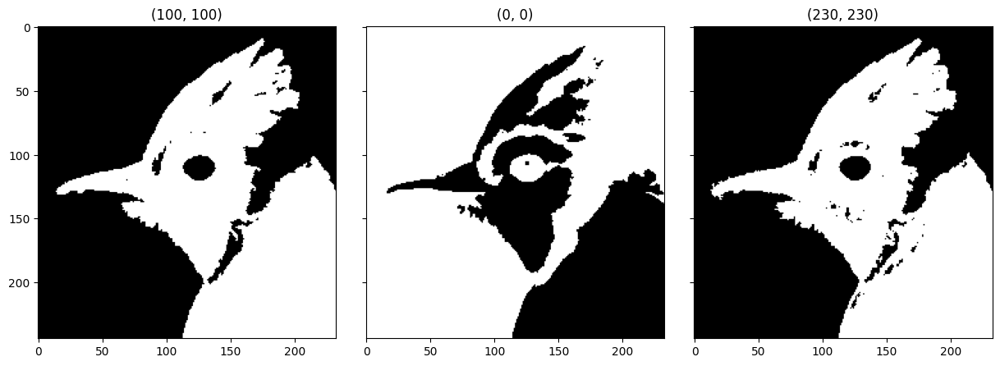

In [55]:
# define set of seed pixel points
x, y = 100, 100
x2, y2 = 0, 0
x3, y3 = 230, 230

# run region growing algorithm
seg_img = region_growing(gray_img, x, y, thresh=80, connectivity=4)
seg_img_x2_y2 = region_growing(gray_img, x2, y2, thresh=80, connectivity=4)
seg_img_x3_y3 = region_growing(gray_img, x3, y3, thresh=80, connectivity=4)

# Show Original and segmented image
fig, axis = plt.subplots(1, 3, figsize=(15,10), sharey=True)
fig.subplots_adjust(wspace=0.1, hspace=0.05)
axis[0].imshow(seg_img, 'gray')
axis[0].set_title(f'({x}, {y})')

axis[1].imshow(seg_img_x2_y2, 'gray')
axis[1].set_title(f'({x2}, {y2})')

axis[2].imshow(seg_img_x3_y3, 'gray')
axis[2].set_title(f'({x3}, {y3})')
plt.show()

In [105]:
# Write your own code here
from collections import deque
def region_growing_avg(img, x, y, thresh=100, connectivity=8, use_multiple_seed_points=False):
    '''
    Impelemnt region growing algorithm to segment a gray scaled image into regions
    :param img: gray scaled image [H, W]
    :param x, y: coordinate of the seed pixel
    :param thresh: region growing threshold
    :return: segmented image [H, W]
    '''
    assert img.ndim == 2, "Expect a gray-scale image!!!"
    # Write your own code here
    segmented_img = np.zeros_like(img, dtype=np.uint8)
    if(use_multiple_seed_points):
        points = 1000
        center_x, center_y = H // 2, W // 2
        radius = min(H, W) // 4  # Defines the region of interest around the center
    
        # Generate random points within the square region around the center
        random_x = np.random.randint(center_x - radius, center_x + radius, size=points)
        random_y = np.random.randint(center_y - radius, center_y + radius, size=points)
        seed_values = img[random_x, random_y]
        seed_value = np.sum(seed_values)/points
        
    else:    
        seed_value = img[x,y]
    queue = deque()
    queue.append((x, y))

    visited = np.zeros_like(img, dtype=bool)

    if connectivity == 8:
        neighbors = [(-1, 0), (1, 0), (0, -1), (0, 1), (-1, -1), (-1, 1), (1, -1), (1, 1)]
    else:
        neighbors = [(-1, 0), (1, 0), (0, -1), (0, 1)]
    iterations = 0
    while queue:
        cx, cy = queue.popleft()
            # Skip if the pixel is out of bounds or already visited
        if cx < 0 or cy < 0 or cx >= H or cy >= W or visited[cx, cy]:
            continue
    
        # Mark the pixel as visited
        visited[cx, cy] = True
        
        # Check if the pixel should be added to the region
        img_region_pixel = []
        for dx, dy in neighbors:
            nx, ny = cx + dx, cy + dy
            if 0 <= nx < H and 0 <= ny < W and not visited[nx, ny]:
                img_region_pixel.append(img[nx, ny])
        img_pixel_region_avg = np.sum(img_region_pixel) / len(img_region_pixel)
        smallest_difference = np.absolute(img_region_pixel - img_pixel_region_avg)

        if(len(img_region_pixel) == 0):
            pixel_to_add = 0
        else:
            pixel_to_add = img_region_pixel[np.where(smallest_difference == np.min(smallest_difference))[0][0]]

        if abs(int(pixel_to_add) - int(seed_value)) <= thresh:
            segmented_img[cx,cy] = 255
        # segmented_img[cx,cy] = pixel_to_add
        
        
        # Add similar neighbors to queue
        for dx, dy in neighbors:
            nx, ny = cx + dx, cy + dy
            if 0 <= nx < H and 0 <= ny < W and not visited[nx, ny]:
                queue.append((nx, ny))

        # if(iterations % 250 == 0):
        #     plt.imshow(segmented_img, 'gray')
        #     plt.savefig(f'Lab2-Figs/region-growing-iteration-{iterations}')
        #     plt.close()

        # iterations += 1
    return segmented_img
   


177.0


C:\Users\Ethan\AppData\Local\Temp\ipykernel_11372\118056004.py:41: RuntimeWarning: invalid value encountered in scalar divide
  img_pixel_region_avg = np.sum(img_region_pixel) / len(img_region_pixel)


0


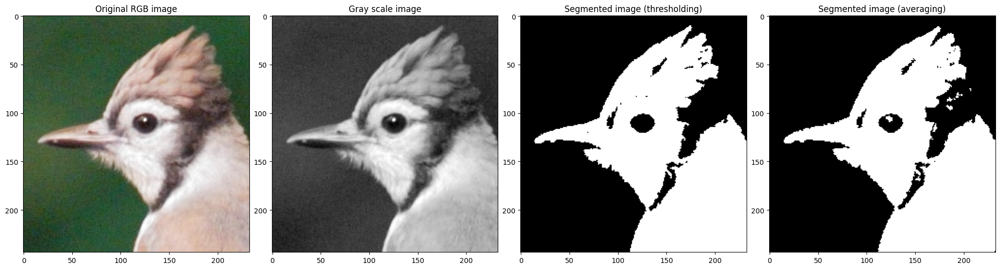

In [59]:
# define set of seed pixel points
x, y = 100, 100

# run region growing algorithm
# seg_img = region_growing(gray_img, x, y, thresh=100, connectedness=4)
seg_img2 = region_growing_avg(gray_img, x, y, thresh=80)
print(seg_img2[0,0])

# Show Original and segmented image
fig, axis = plt.subplots(1, 4, figsize=(25,25))
fig.subplots_adjust(wspace=0.1, hspace=0.05)
axis[0].imshow(img)
axis[0].set_title('Original RGB image')

axis[1].imshow(gray_img, 'gray')
axis[1].set_title('Gray scale image')

axis[2].imshow(seg_img, 'gray')
axis[2].set_title('Segmented image (thresholding)')

axis[3].imshow(seg_img2, 'gray')
axis[3].set_title('Segmented image (averaging)')
plt.show()

177.0


C:\Users\Ethan\AppData\Local\Temp\ipykernel_11372\118056004.py:41: RuntimeWarning: invalid value encountered in scalar divide
  img_pixel_region_avg = np.sum(img_region_pixel) / len(img_region_pixel)


177.0
0


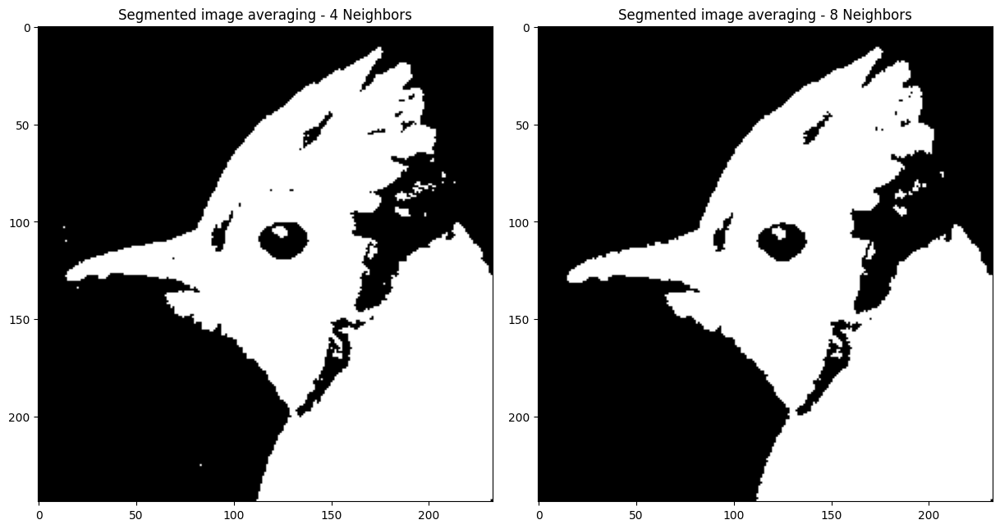

In [62]:
# define set of seed pixel points
x, y = 100, 100

# run region growing algorithm
# seg_img = region_growing(gray_img, x, y, thresh=100, connectedness=4)
seg_img_neighbors_8 = region_growing_avg(gray_img, x, y, thresh=80)
seg_img_neighbors_4 = region_growing_avg(gray_img, x, y, thresh=80, connectivity=4)
print(seg_img2[0,0])

# Show Original and segmented image
fig, axis = plt.subplots(1, 2, figsize=(15,15))
fig.subplots_adjust(wspace=0.1, hspace=0.05)
axis[0].imshow(seg_img_neighbors_4, 'gray')
axis[0].set_title('Segmented image averaging - 4 Neighbors')

axis[1].imshow(seg_img_neighbors_8, 'gray')
axis[1].set_title('Segmented image averaging - 8 Neighbors')
plt.show()

### More things to try out:
1. What kind of connectivity did you use for considering neighbour pixels? If you used 4- connectivity, try 8-connectivity, if you used 8-connectivity then try 4-connectivity.
    Does this change results?
    
2. What if there are multiple regions of interest? Consider using multiple seed points. How will you choose these?

C:\Users\Ethan\AppData\Local\Temp\ipykernel_11372\132154406.py:52: RuntimeWarning: invalid value encountered in scalar divide
  img_pixel_region_avg = np.sum(img_region_pixel) / len(img_region_pixel)


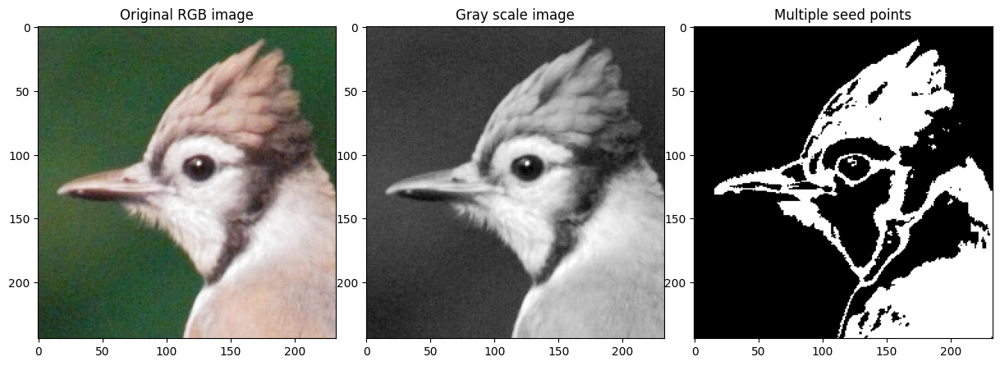

In [118]:
# define set of seed pixel points
x, y = 100, 100

# run region growing algorithm
seg_img_multiple_seed_points = region_growing_avg(gray_img, x, y, thresh=50, use_multiple_seed_points=True)

# Show Original and segmented image
fig, axis = plt.subplots(1, 3, figsize=(15,15))
fig.subplots_adjust(wspace=0.1, hspace=0.05)
axis[0].imshow(img)
axis[0].set_title('Original RGB image')

axis[1].imshow(gray_img, 'gray')
axis[1].set_title('Gray scale image')

axis[2].imshow(seg_img_multiple_seed_points, 'gray')
axis[2].set_title('Multiple seed points')

plt.show()

## Task 3: Connected Components 

Connected-component labeling (also known as connected-component analysis, or region labeling) is an algorithmic application of graph theory that is used to determine the connectivity of “blob”-like regions in a binary image.
Specifically, the algorithm labels each connected component of a binary image with a separate number.

Similar to Region Growing, for a single connected-component we can start from a seed and iteratively traverse all the neighbouring pixels. In this case, a Depth-first Serach (DFS) is a better way:

Then we just need to repeat this process for all the connected components in the image.

In [44]:
def connected_components_label(img, connectedness=4):
    rows, columns = img.shape  # Image dimensions
    queue = deque()
    print(rows,columns)
    visited = np.zeros_like(img, dtype=bool)
    segmented_img  = np.zeros_like(img, dtype=np.uint8)
    neighbors = [(-1, 0), (1, 0), (0, -1), (0, 1), (-1, -1), (-1, 1), (1, -1), (1, 1)]
    
    region = 1
    for cx in range(rows):
        for cy in range(columns):
            if img[cx, cy] == 1 and not visited[cx, cy]:
                # Start BFS from this pixel
                queue.append((cx, cy))
                while queue:
                    cx, cy = queue.popleft()
                    if visited[cx, cy]:
                        continue
            
                    # Mark the pixel as visited
                    visited[cx, cy] = True
                    segmented_img[cx,cy] = region
                    
                   # neighboring_cells = []
                    for dx, dy in neighbors:
                        nx, ny = cx + dx, cy + dy
                        if 0 <= nx < rows and 0 <= ny < columns and img[nx, ny] == 1 and not visited[nx, ny]:
                            queue.append((nx, ny))
                region +=1


    return segmented_img

# Write your own code here

244 233


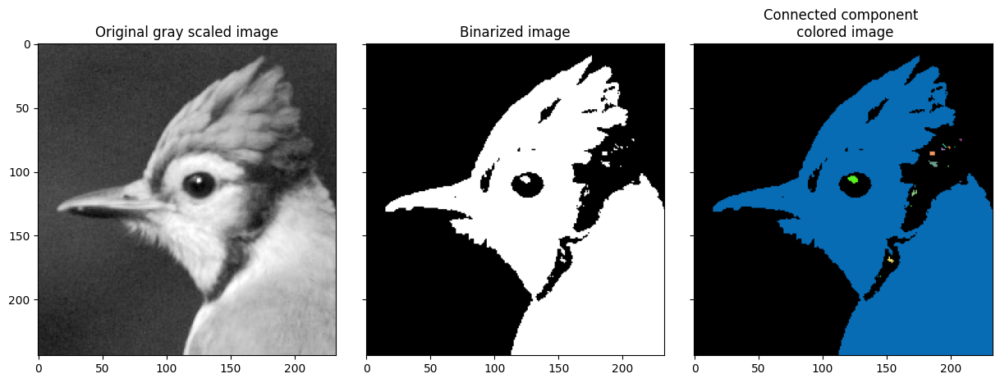

In [45]:
from utils import colourize

bimg = (gray_img > 100).astype(np.float32)
ccl_img = connected_components_label(bimg)

fig, axis = plt.subplots(1, 3, figsize=(15,10), sharey=True)
fig.subplots_adjust(wspace=0.1, hspace=0.05)
axis[0].imshow(gray_img, 'gray')
axis[0].set_title('Original gray scaled image')

axis[1].imshow(bimg, 'gray')
axis[1].set_title('Binarized image')

axis[2].imshow(colourize(ccl_img))
axis[2].set_title('Connected component \n colored image')
plt.show()

The previous image was not a very good example to showcase the connected component algorithm. Next, you will see a better image.

292 612


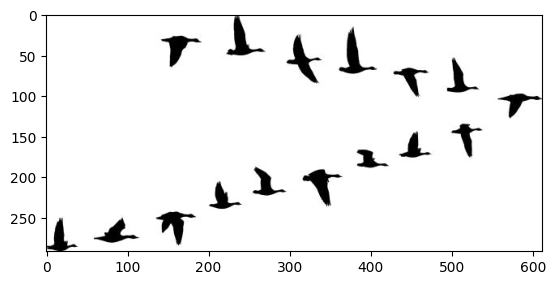

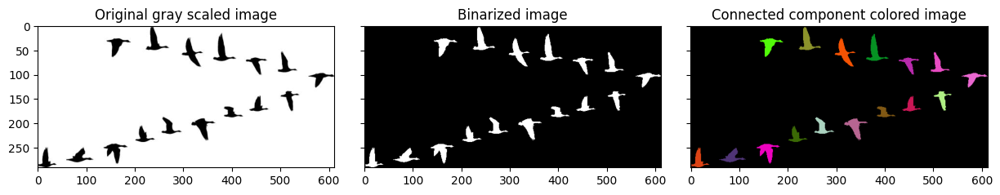

In [46]:
img2 = cv2.imread("../dataset/gooses.jpg")
gray_img2 = cv2.cvtColor(img2, cv2.COLOR_BGR2GRAY).astype(np.float32)
plt.imshow(gray_img2, 'gray')

bimg2 = (gray_img2 < 100).astype(np.float32)
ccl_img2 = connected_components_label(bimg2)

fig, axis = plt.subplots(1, 3, figsize=(15,10), sharey=True)
fig.subplots_adjust(wspace=0.1, hspace=0.05)
axis[0].imshow(gray_img2, 'gray')
axis[0].set_title('Original gray scaled image')

axis[1].imshow(bimg2, 'gray')
axis[1].set_title('Binarized image')

axis[2].imshow(colourize(ccl_img2))
axis[2].set_title('Connected component colored image')
plt.show()

### Tasks
Your task is to count the number of candies in the image below (Candy1):
1. Show your code and intermediate results for each step
2. Explain how the parameters were selected and what prior information you use.
3. Report your answer
4. Try your code on Candy2 without anychanges and report reuslt, discuss how would you improve the method for them.

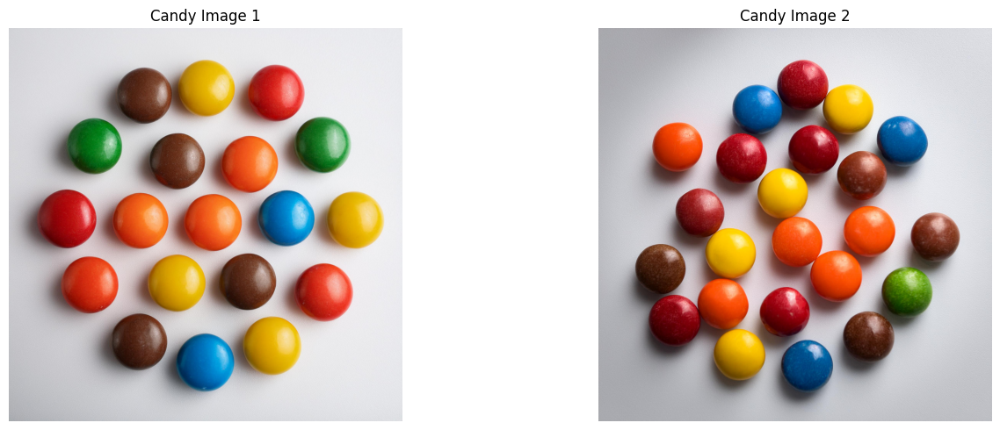

In [47]:
# Read first candy image
img1 = cv2.imread('../dataset/candy1.jpeg')
# Convert BGR to RGB for correct color display
img1_rgb = cv2.cvtColor(img1, cv2.COLOR_BGR2RGB)

# Read second candy image
img2 = cv2.imread('../dataset/candy2.jpeg')
# Convert BGR to RGB for correct color display
img2_rgb = cv2.cvtColor(img2, cv2.COLOR_BGR2RGB)

# Create figure with two subplots side by side
plt.figure(figsize=(15, 5))

# Display first image
plt.subplot(1, 2, 1)
plt.imshow(img1_rgb)
plt.title('Candy Image 1')
plt.axis('off')

# Display second image
plt.subplot(1, 2, 2)
plt.imshow(img2_rgb)
plt.title('Candy Image 2')
plt.axis('off')

plt.tight_layout()
plt.show()

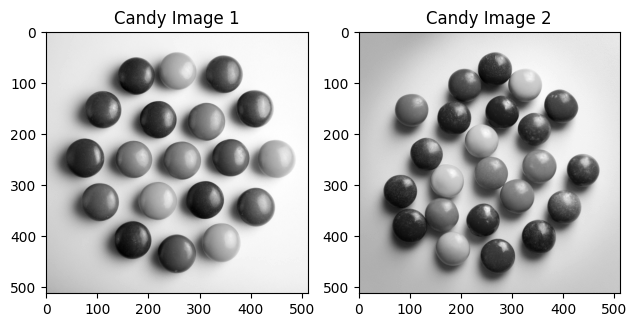

In [48]:
img1_grey = cv2.cvtColor(img1, cv2.COLOR_BGR2GRAY)
img2_grey = cv2.cvtColor(img2, cv2.COLOR_BGR2GRAY)

img1_grey = cv2.resize(img1_grey, (512,512), interpolation = cv2.INTER_AREA)
img2_grey = cv2.resize(img2_grey, (512,512), interpolation = cv2.INTER_AREA)

plt.subplot(1, 2, 1)
plt.imshow(img1_grey, 'gray')
plt.title('Candy Image 1')

# Display second image
plt.subplot(1, 2, 2)
plt.imshow(img2_grey, 'gray')
plt.title('Candy Image 2')

plt.tight_layout()
plt.show()

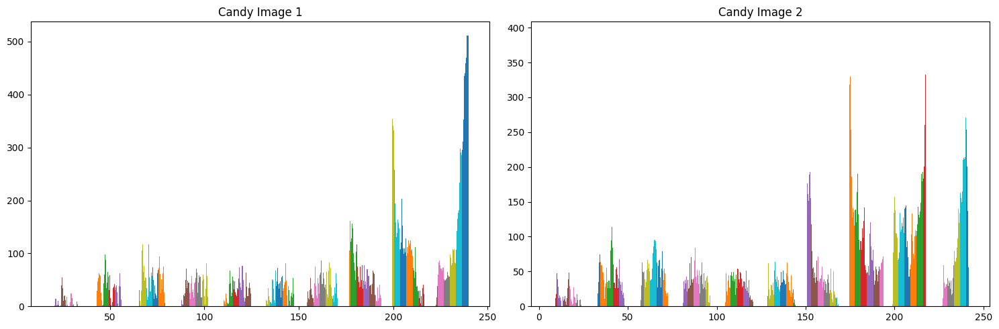

In [49]:
plt.figure(figsize=(15, 5))

# Display first image
plt.subplot(1, 2, 1)
plt.hist(img1_grey)
plt.title('Candy Image 1')

# Display second image
plt.subplot(1, 2, 2)
plt.hist(img2_grey)
plt.title('Candy Image 2')

plt.tight_layout()
plt.show()


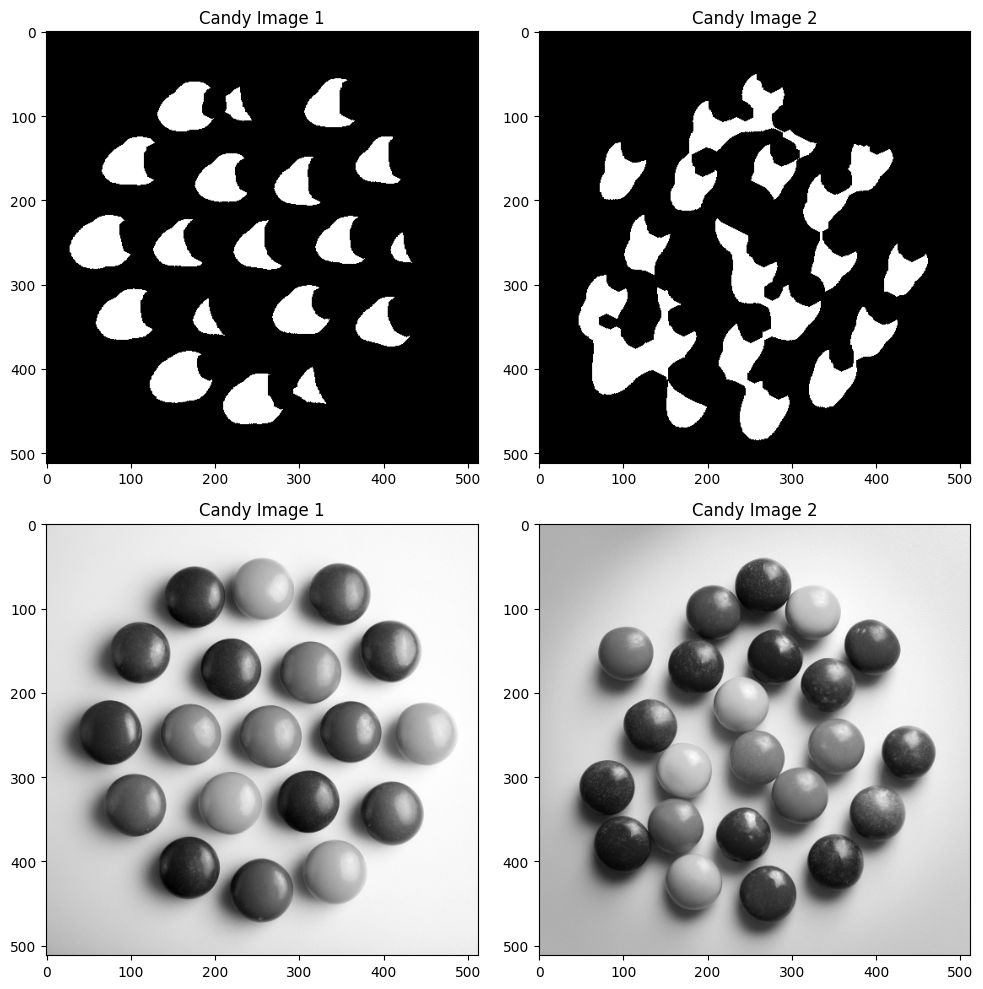

In [50]:
binary_img1 = ((10 < img1_grey) & (img1_grey < 150)).astype(float)
binary_img2 = ((10 < img2_grey) & (img2_grey < 150)).astype(float)

kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (5, 5))
# kernel2 = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (4, 4))
# kernel3 = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (3, 3))

# binary_img1 = cv2.morphologyEx(binary_img1, cv2.MORPH_CLOSE, kernel)


binary_img1 = cv2.erode(binary_img1, kernel, iterations=4)  # Erode the image
binary_img2 = cv2.erode(binary_img2, kernel, iterations=4)  # Erode the image

# binary_img2 = cv2.morphologyEx(binary_img2, cv2.MORPH_OPEN, kernel3)

plt.figure(figsize=(10, 10))

# Display first image
plt.subplot(2, 2, 1)
plt.imshow(binary_img1, 'gray')
plt.title('Candy Image 1')

# Display second image
plt.subplot(2, 2, 2)
plt.imshow(binary_img2, 'gray')
plt.title('Candy Image 2')

# Display 3 image
plt.subplot(2, 2, 3)
plt.imshow(img1_grey, 'gray')
plt.title('Candy Image 1')

# Display 4 image
plt.subplot(2, 2, 4)
plt.imshow(img2_grey, 'gray')
plt.title('Candy Image 2')

plt.tight_layout()
plt.show()


In [51]:
def connected_components_label_and_count(img):
    rows, columns = img.shape  # Image dimensions
    queue = deque()
    print(rows,columns)
    visited = np.zeros_like(img, dtype=bool)
    segmented_img  = np.zeros_like(img, dtype=np.uint8)
    neighbors = [(-1, 0), (1, 0), (0, -1), (0, 1), (-1, -1), (-1, 1), (1, -1), (1, 1)]

    region = 1
    for cx in range(rows):
        for cy in range(columns):
            if img[cx, cy] == 1 and not visited[cx, cy]:
                # Start BFS from this pixel
                queue.append((cx, cy))
                while queue:
                    cx, cy = queue.popleft()
                    if visited[cx, cy]:
                        continue

                    # Mark the pixel as visited
                    visited[cx, cy] = True
                    segmented_img[cx,cy] = region

                    # neighboring_cells = []
                    for dx, dy in neighbors:
                        nx, ny = cx + dx, cy + dy
                        if 0 <= nx < rows and 0 <= ny < columns and img[nx, ny] == 1 and not visited[nx, ny]:
                            queue.append((nx, ny))
                region +=1


    return segmented_img, region-1

# Write your own code here

512 512
512 512


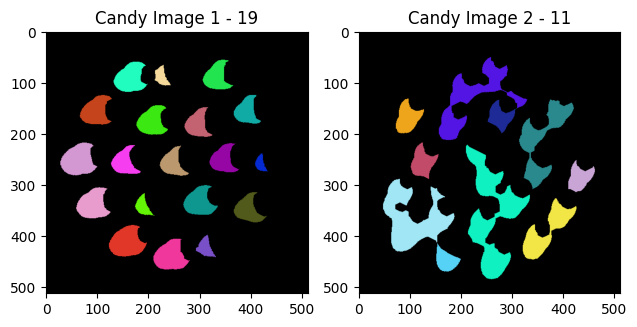

In [52]:
ccl_img1, count_1 = connected_components_label_and_count(binary_img1)
ccl_img2, count_2 = connected_components_label_and_count(binary_img2)

# plt.figure(figsize=(15, 5))

# Display first image
plt.subplot(1, 2, 1)
plt.imshow(colourize(ccl_img1))
plt.title(f'Candy Image 1 - {count_1}')

# Display second image
plt.subplot(1, 2, 2)
plt.imshow(colourize(ccl_img2))
plt.title(f'Candy Image 2 - {count_2}')

plt.tight_layout()
plt.show()


# Part 2: Filter
In the last lecture you learned about linear image filtering operations like correlation and
convolution and how these can be applied directly on the image.
These kind of filtering operations have many uses, ranging from smoothing and noise
reduction, to feature enhancement and sharpening, calculating image derivatives, edge
detection and even template matching.
Your task today is to code your own linear filtering functions operating on the image domain.

In [2]:
import numpy as np
import cv2
import matplotlib.image as mpimg
from matplotlib import pyplot as plt
# to visualize the plots within the notebook
%matplotlib inline

## Task 4 Convolution
Convolution is a fundamental operation for applying linear filters to images. It takes as input
an image (greyscale) I and a filter kernel K and returns the result I’ of convolving the image
with this filter.

Definition: Given a greyscale image I and a filter K of size (2N + 1) x (2M + 1) (we use odd
dimension filters like 3 x 3, 5 x 5 etc.), convolution is defined as:

\begin{equation}
I'(x, y) = \sum_{i=-a}^a \sum_{j=-b}^b K(i, j) I(x - i, y - j)
\end{equation}

Your task is to write your own convolution function (do not use the conv2() function) and test
it with different filters. How will you handle the behaviour of the filter in the edges of the
image (pad with zeros, copy the edge etc.)?

Smoothing filters that reduce noise in images are quite useful in image processing. Use a
simple mean filter like:

\begin{equation}
\begin{bmatrix}1 & 1 & 1\\1 & 1 & 1\\1 & 1 & 1\end{bmatrix}
\end{equation}

This filter replaces each pixel by the average of its neighbourhood. Now if we want
something better, we can try weighing the contributions of the neighbouring pixels by their
proximity to the centre pixel. Try a Gaussian filter, which is defined as: 

\begin{equation}
G_{\sigma} = \frac{1}{2\pi \sigma^2} e^{-\frac{(x^2 + y^2)}{2 \sigma^2}}
\end{equation}

where $\sigma$ is the standard deviationof the Gaussian. This is a continuous function, so your filter will need to sample it in both x and y directions (use np.meshgrid()), keeping in mind the value for $\sigma$ that you chose. Try different filter sizes and different values for $\sigma$ and compare the results. Here is the results obtained using opencv built-in functions. If your implementation is correct, you should expect to have similar results.

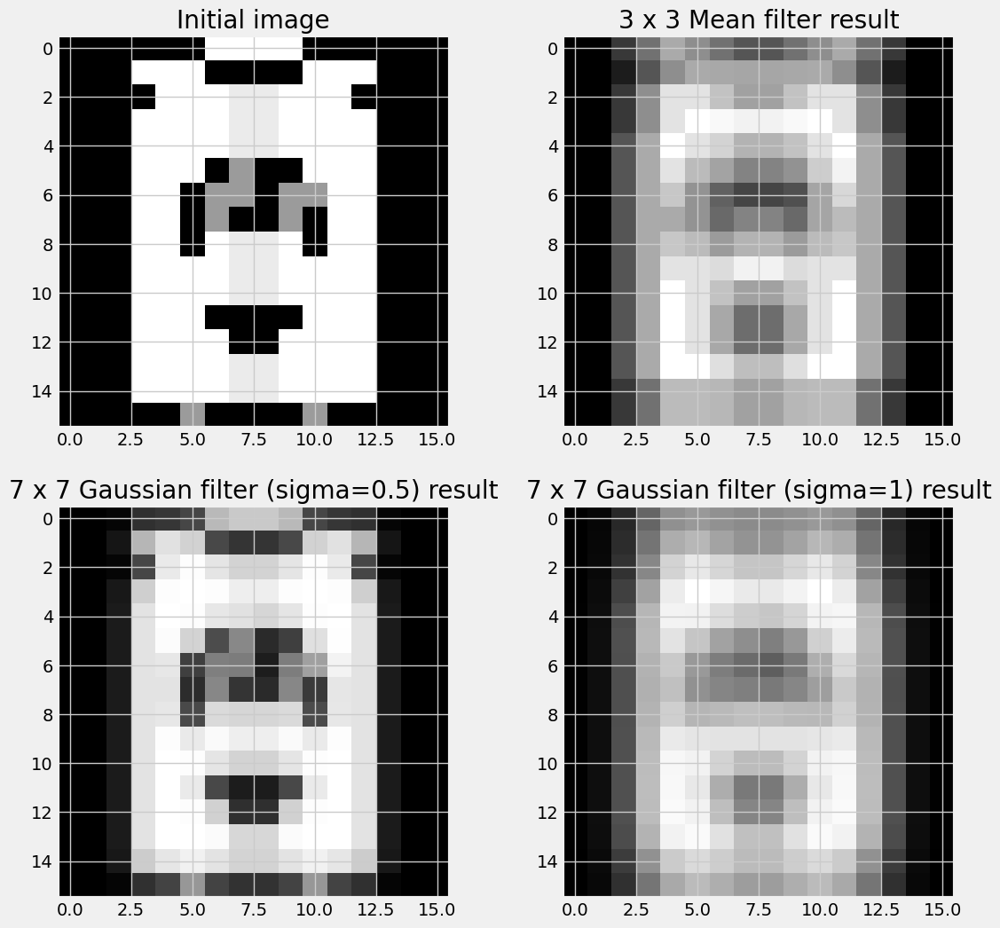

In [117]:
img = cv2.imread("../dataset/pixel.png")
img_gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY).astype(np.float32)
mean_blur = cv2.blur(img_gray, (3, 3))  # mean filter 3x3
gaussian_1 = cv2.GaussianBlur(img_gray, (7, 7), 0.5, 0.5)  # gaussian filter 7x7, sigma = 0.5
gaussian_2 = cv2.GaussianBlur(img_gray, (7, 7), 1., 1.)  # gaussian filter 7x7, sigma = 1.0
fig = plt.figure(figsize=(12, 12))
ax1 = plt.subplot(2, 2, 1)
ax1.title.set_text("Initial image")
plt.imshow(img_gray, "gray")
ax2 = plt.subplot(2, 2, 2)
ax2.title.set_text("3 x 3 Mean filter result")
plt.imshow(mean_blur, "gray")
ax3 = plt.subplot(2, 2, 3)
ax3.title.set_text("7 x 7 Gaussian filter (sigma=0.5) result")
plt.imshow(gaussian_1, "gray")
ax4 = plt.subplot(2, 2, 4)
ax4.title.set_text("7 x 7 Gaussian filter (sigma=1) result")
plt.imshow(gaussian_2, "gray")
plt.show()

### Implement your own code here:

hint: You can use `cv2.copyMakeBorder` to do paddings to the image. Figure out how to use it by yourself!

In [119]:
"""
Implement your code here
"""
def apply_filter(src_img, kernel):
    '''
    Impelemnt filtering algorithm
    :param src_img: gray scaled source image with size HxW
    :param kernel: kernel to be applied to the source image
    :return rst_img: filtered image
    '''
    assert len(src_img.shape) == 2, print("Dimension mismatch! Please supply gray-scale image only!")
    assert len(kernel.shape) == 2, print("Dimension mismatch! Please supply 2D kernel only!")
    kernel_height, kernel_width = kernel.shape
    img_height, img_width = src_img.shape
    
    height_to_add = kernel_height // 2
    width_to_add = kernel_width // 2

    image = cv2.copyMakeBorder(src_img, height_to_add, height_to_add, width_to_add, width_to_add, cv2.BORDER_CONSTANT, None, value = 0)
    conv_image = np.zeros_like(src_img, dtype=np.float32)
    
    images = []
    iterations = 0
    for i in range(img_height):
        for j in range(img_width):
            region = image[i:i+kernel_height, j:j+kernel_width]
            conv_image[i,j] = np.sum(region * kernel)
            # plt.imshow(conv_image,'gray')
            # plt.savefig(f'conv/tmp-{iterations}.png')
            # plt.close()
            iterations += 1

    return conv_image




def get_mean_filter_kernel(h, w):
    '''
    Get kernel of mean filter
    '''
    kernel = (1/(h*w)) * np.ones((h,w))
    return kernel
def get_gaussian_kernel(h, w, sigma):
    '''
    Get kernel of Gaussian filter
    '''
    assert (h % 2 == 1) and (w % 2 == 1), print("kernal size must be odd number!")
    x = np.arange(-(h // 2), h // 2 + 1, 1.)
    y = np.arange(-(w // 2), w // 2 + 1, 1.)
    xx, yy = np.meshgrid(x, y)
    two_sigma_2 = 2 * sigma ** 2
    G = np.exp(-(xx ** 2 + yy ** 2) / two_sigma_2) / (two_sigma_2 * np.pi)
    G /= G.sum()
    return G

In [120]:
"""
Get kernels and apply filter here
"""
k_mean = get_mean_filter_kernel(3, 3)
G1 = get_gaussian_kernel(7, 7, 0.5)
G2 = get_gaussian_kernel(7, 7, 1.)
img_filter_applied = apply_filter(img_gray, k_mean)
# img_gaussian_1 = apply_filter(img_gray, G1)
# img_gaussian_2 = apply_filter(img_gray, G2)


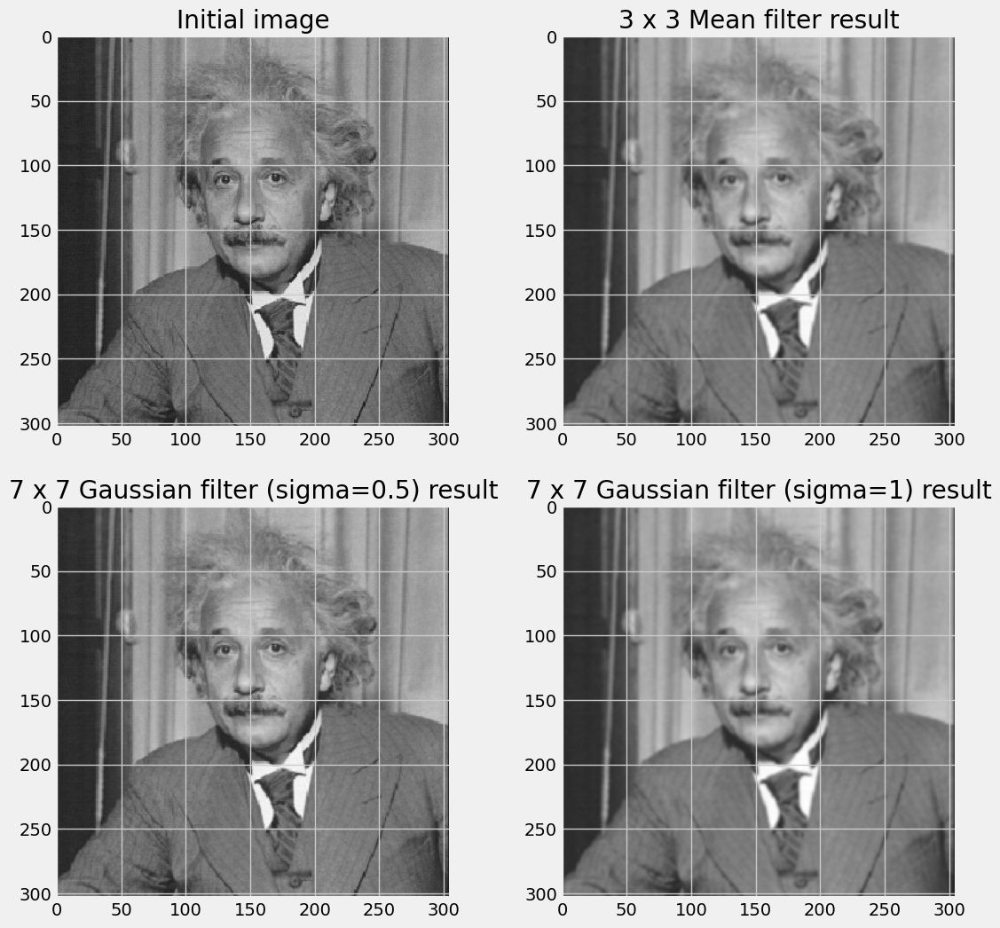

In [48]:

"""
Plot the results
"""
fig = plt.figure(figsize=(12, 12))
ax1 = plt.subplot(2, 2, 1)
ax1.title.set_text("Initial image")
plt.imshow(img_gray, "gray")
ax2 = plt.subplot(2, 2, 2)
ax2.title.set_text("3 x 3 Mean filter result")
plt.imshow(img_filter_applied, "gray")
ax3 = plt.subplot(2, 2, 3)
ax3.title.set_text("7 x 7 Gaussian filter (sigma=0.5) result")
plt.imshow(img_gaussian_1, "gray")
ax4 = plt.subplot(2, 2, 4)
ax4.title.set_text("7 x 7 Gaussian filter (sigma=1) result")
plt.imshow(img_gaussian_2, "gray")
plt.show()

## Task 5: Edge Detection with Sobel Filter
The Sobel filter is commonly used to detect edges in images by calculating the gradient of the image intensity. It emphasizes areas of high spatial frequency that correspond to edges. Here, we will apply the Sobel filter to detect edges in the grayscale image of Albert Einstein.

We start by applying separate Sobel filters in both the x and y directions, which will highlight horizontal and vertical edges, respectively. The combined result will provide a comprehensive edge map of the entire image.



### Tasks:
* Use your own kenel and extract edge on x and y with sobel filter with only numpy.
* Using the package - *time* does your algorithm compare to the built-in median filtering of opencv? Also, measure the time difference and compare result from your implementation and opencv

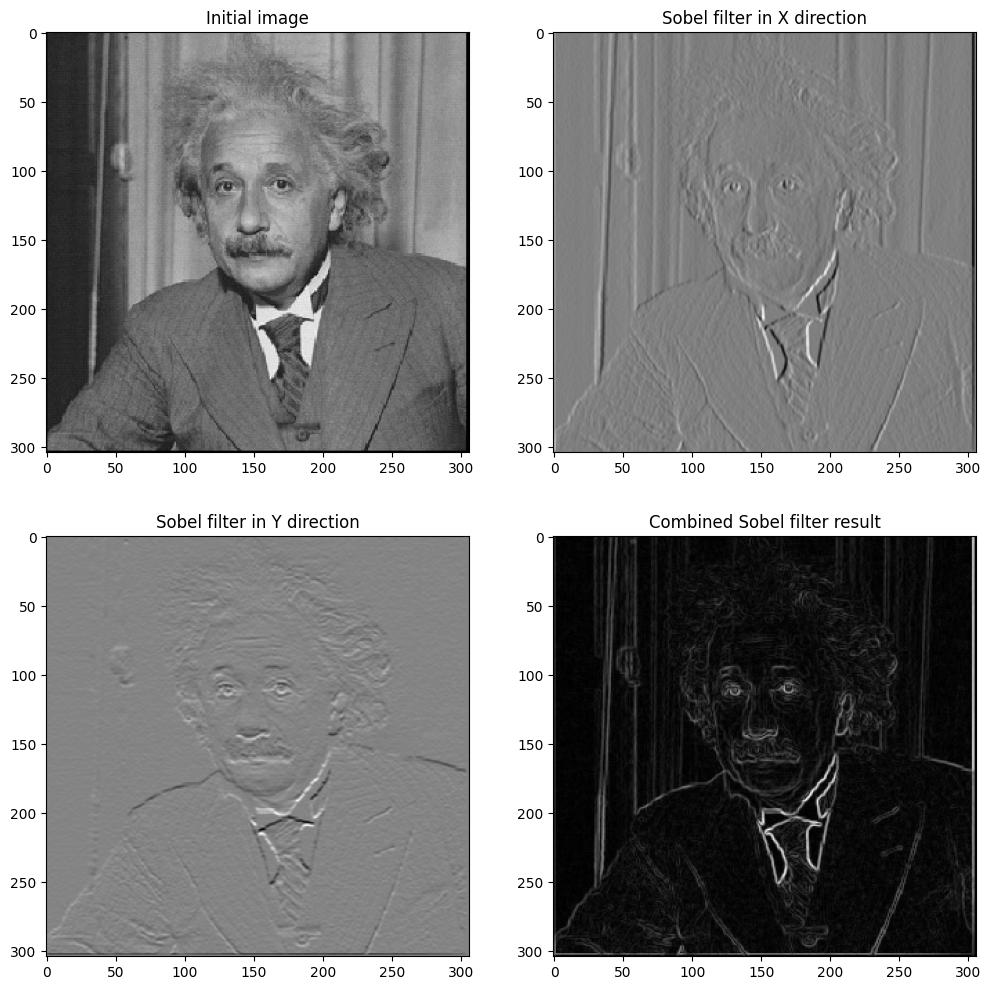

In [59]:
img = cv2.imread("../dataset/einstein.png")
img_gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY).astype(np.float32)
sobel_x = cv2.Sobel(img_gray, cv2.CV_64F, 1, 0, ksize=3)  # Sobel filter in x direction
sobel_y = cv2.Sobel(img_gray, cv2.CV_64F, 0, 1, ksize=3)  # Sobel filter in y direction
sobel_combined = cv2.magnitude(sobel_x, sobel_y)  # Combine the gradients
fig = plt.figure(figsize=(12, 12))
ax1 = plt.subplot(2, 2, 1)
ax1.title.set_text("Initial image")
plt.imshow(img_gray, "gray")
ax2 = plt.subplot(2, 2, 2)
ax2.title.set_text("Sobel filter in X direction")
plt.imshow(sobel_x, "gray")
ax3 = plt.subplot(2, 2, 3)
ax3.title.set_text("Sobel filter in Y direction")
plt.imshow(sobel_y, "gray")
ax4 = plt.subplot(2, 2, 4)
ax4.title.set_text("Combined Sobel filter result")
plt.imshow(sobel_combined, "gray")
plt.show()


### Strong Edge and Orientation Detection - Extra stuff we did

The orientation of the gradient at each pixel is calculated using the arctangent of the ratio of the vertical gradient (\(G_y\)) to the horizontal gradient (\(G_x\)):


\begin{equation}
\theta = \arctan\left(\frac{G_y}{G_x}\right)
\end{equation}


Where:
- \(G_x\): Gradient in the horizontal direction (e.g., computed using the Sobel X kernel).
- \(G_y\): Gradient in the vertical direction (e.g., computed using the Sobel Y kernel).



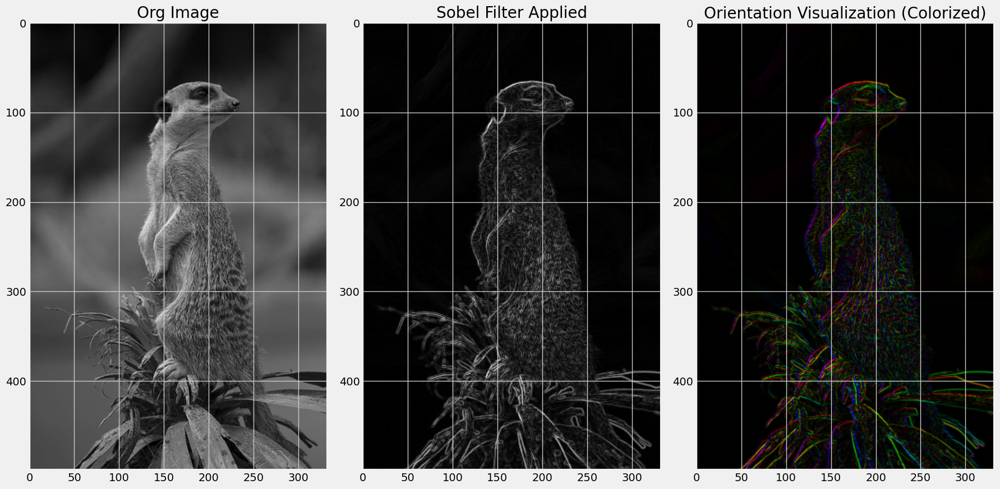

In [108]:
from utils import colourize

img = cv2.imread("../dataset/meerkat.jpg")
img_gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY).astype(np.float32)

kernel = get_mean_filter_kernel(3,3)

sobel_y = np.array([[-1,-2,-1], [0,0,0], [1,2,1]])
sobel_x = np.array([[-1,0,1], [-2,0,2], [-1,0,1]])
img_filter_applied_x = apply_filter(img_gray, sobel_x)
img_filter_applied_y = apply_filter(img_gray, sobel_y)
img_filter_applied = np.sqrt(img_filter_applied_y**2 + img_filter_applied_x**2)

orientation = np.arctan2(img_filter_applied_y, img_filter_applied_x)

# Normalize orientation to [0, 1] for hue mapping
orientation_normalized = (orientation + np.pi) / (2 * np.pi)  # Map [-π, π] to [0, 1]

# Normalize gradient magnitude for value channel
gradient_magnitude_normalized = cv2.normalize(img_filter_applied, None, 0, 1, cv2.NORM_MINMAX)

# Create an HSV image
hsv = np.zeros_like(img, dtype=np.float32)
hsv[..., 0] = orientation_normalized  # Hue
hsv[..., 1] = 1.0                     # Saturation
hsv[..., 2] = gradient_magnitude_normalized  # Value based on edge strength

# Convert HSV to RGB for visualization
rgb = cv2.cvtColor((hsv * 255).astype(np.uint8), cv2.COLOR_HSV2RGB)

#img[((orientation > (np.pi/2)) & (img_filter_applied > 50))] = [255, 0, 0]

fig = plt.figure(figsize=(24, 12))

plt.subplot(1, 4, 1)
plt.imshow(img_gray, 'gray')
plt.title(f'Org Image')

plt.subplot(1, 4, 2)
plt.imshow(img_filter_applied,'gray')
plt.title(f'Sobel Filter Applied')

# Display second image
plt.subplot(1, 4, 3)
plt.imshow(rgb)
plt.title(f'Orientation Visualization (Colorized)')


plt.tight_layout()
plt.show()



# Part 3: Corner Detection

In the second lecture of the week we went through about corner detection algorithms and how these can be used to find
interesting features on an image that can be used in applications such as stereo matching,
3D reconstruction, tracking, localization and recognition.
Our task here is to code two corner detection algorithms, the Moravec and the Harris
corner detector.

In [1]:
import numpy as np
import copy
import cv2
from matplotlib import pyplot as plt
import random
from PIL import Image
#to visualize the plots within the notebook
%matplotlib inline
# for making plots looking nicer
plt.style.use('fivethirtyeight')

## Task 6: Moravec corner detector

The Moravec corner detector uses a patch centred on each pixel as its own matching
template. The patch is shifted so that it is centred on each of the 8 neighbours of the pixel
and the sum of squared differences (SSD) is calculated between the original patch and the
shifted patch:

$$
    E = \sum_{\Delta \mathbf{x}} w(\Delta \mathbf{x})\big(I(\mathbf{x} + \Delta \mathbf{x}) - I(\mathbf{x}^{\prime} + \Delta \mathbf{x}\big)^2
$$


$w$ is a weighting function with the same dimension as the patch, you can use a Gaussian or constant weights. The corner metric (cornerness) is then taken to be the minimum of the SSD values calculated for each of the eight shifts of the window.
A pixel is marked as a corner if its cornerness is above a user-specified threshold.


Your task is to write your implementation of the Moravec corner detector.
It will take as input a grayscale image, the window size, the threshold and optionally a Gaussian function for $w$. It will give as output a corner map as a list of pixel coordinates where a corner is detected.


In [2]:
def draw_corners(image, corners_map, color=(255, 0, 0)):
    """Draw a point for each possible corner.
    color image: [H, W, 3]
    corners_map: list of pixel coordinates (xy indexing)
    """
    
    color_img = cv2.cvtColor(image[:,:,0], cv2.COLOR_GRAY2BGR)
    for corner in corners_map:
        cv2.circle(color_img, corner, 1, color, -1)
    return color_img

def make_mean_filter_kernel(h, w):
    return np.ones((h, w)) / (h * w)

def make_gaussian_kernel(h, w, sigma):
    assert (h % 2 == 1) and (w % 2 == 1), print("kernal size must be odd number!")
    
    x = np.arange(-(h // 2), h // 2 + 1, 1.)
    y = np.arange(-(w // 2), w // 2 + 1, 1.)
    xx, yy = np.meshgrid(x, y)
    two_sigma_2 = 2 * sigma ** 2
    G = np.exp(-(xx ** 2 + yy ** 2) / two_sigma_2) / (two_sigma_2 * np.pi)
    G /= G.sum()
    return G

def SSD(patch1, patch2, weight):
    return (weight * (patch1 - patch2) ** 2).sum()

def moravec(image, window_size=3, threshold=100., weights=None):
    """Moravec's corner detection for each pixel of the image.
    image: grayscale image: [H, W]
    """
    assert window_size % 2 == 1, "window size should be an odd number"
    
    neighbours = [(-1, 0), (1, 0), (0, -1), (0, 1), (-1, -1), (-1, 1), (1, -1), (1, 1)]
    if weights is None:
        weights = make_mean_filter_kernel(window_size, window_size)
    
    corners = []
    k = window_size // 2
    H, W = image.shape[0], image.shape[1]
    for i in range(0, H):
        for j in range(0, W):
            if i-k < 0 or j-k < 0 or i+k >= H or j+k >= W:
                continue
            centre_patch = image[i-k:i+k+1, j-k:j+k+1]
            E = []
            for nei in neighbours:
                di, dj = nei
                ii, jj = i + di, j + dj
                if ii-k < 0 or jj-k < 0 or ii+k >= H or jj+k >= W:
                    continue
                patch = image[ii-k:ii+k+1, jj-k:jj+k+1]
                E.append(SSD(centre_patch, patch, weights))
            minE = np.array(E).min()
            if minE > threshold:
                corners.append((j, i))

    return corners

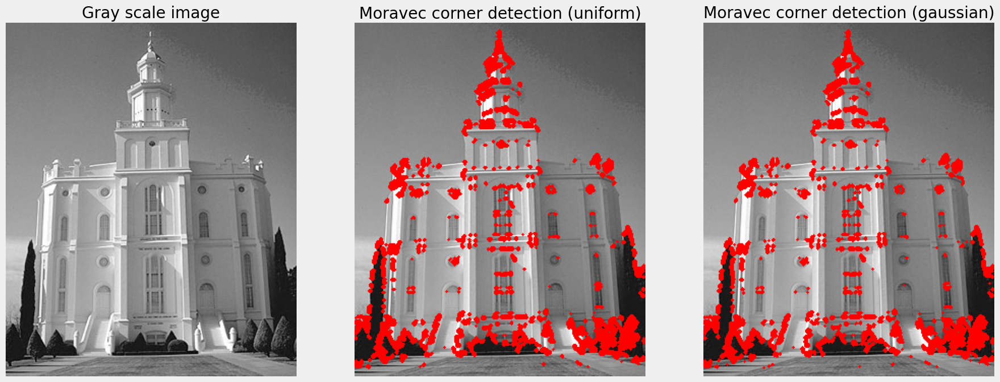

In [3]:
img = cv2.imread('../dataset/building.png')
gray_img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY).astype(np.float32)

moravec_corners = moravec(gray_img, threshold=200.)
img_with_corner = draw_corners(img, moravec_corners)

moravec_corners2 = moravec(gray_img, threshold=200., weights=make_gaussian_kernel(3, 3, 1.0))
img_with_corner2 = draw_corners(img, moravec_corners2)

# Show Original and detected corners on image
fig, axis = plt.subplots(1, 3, figsize=(20, 8), sharey=False)
axis[0].imshow(gray_img, 'gray')
axis[0].grid(False)
axis[0].set_title('Gray scale image')
axis[0].set_axis_off()

axis[1].imshow(img_with_corner, 'gray')
axis[1].grid(False)
axis[1].set_title('Moravec corner detection (uniform)')
axis[1].set_axis_off()

axis[2].imshow(img_with_corner2, 'gray')
axis[2].grid(False)
axis[2].set_title('Moravec corner detection (gaussian)')
axis[2].set_axis_off()

plt.show()

## Task 7: Harris corner detector

The Harris corner detector builds upon the concepts of the Moravec corner detector, but
overcomes its limitations by generalising the measure of cornerness.
The basic limitation of the Moravec detector is that it only calculates cornerness for the 8 main directions
corresponding to the neighbours of a pixel, which means it will not detect a corner in any other direction.
The Harris detector uses the image structure tensor to overcome this. The image structure tensor is:

$$
    S = 
    \begin{pmatrix}
     I^2_x   & I_x I_y\\
     I_x I_y & I^2_y
    \end{pmatrix}
$$

where $I_x$ is the partial derivative of the image in the x direction and $I_y$ is the partial derivative of the image in the y direction.
The structure tensor summarizes the main directions of the gradient of the image for every pixel and therefore its two eigenvalues can be used to determine whether there is a corner at a pixel (if both eigenvalues are large).
The cornerness response metric is then defined as follows:

$$
    C = \text{det}(S) - k \text{tr}(S)^2 \\
$$

where $k$ is a an empirically determined hyper-parameter, usually in the range of $[0.04, 0.06]$

### Non-maximum Suppression (NMS)

In most cases, naivly thresholding the response map will lead to a lot of false-positives, i.e. blobs around real corners. One way to mitigate this to use Non-maximum Suppression (NMS). There is a number of ways of doing it, but the principle is to only keep the pixel with maxium response for aby local regions. You can try by simply setting pixels that have an 8 neighbour with higher cornerness to zero.

In [127]:
"""
Utility functions here, you can use code from the last week. FFT implementation is reccomended as it is faster.
"""
def apply_filter(src_img, kernel, is1DVertical = False):
    '''
    Impelemnt filtering algorithm
    :param src_img: gray scaled source image with size HxW
    :param kernel: kernel to be applied to the source image
    :return rst_img: filtered image
    '''
    assert len(src_img.shape) == 2, print("Dimension mismatch! Please supply gray-scale image only!")
    if(not is1DVertical):
        assert len(kernel.shape) == 2, print("Dimension mismatch! Please supply 2D kernel only!")
        kernel_height, kernel_width = kernel.shape
    else:
        kernel_height = kernel.size
        kernel_width = 1
    img_height, img_width = src_img.shape

    height_to_add = kernel_height // 2
    width_to_add = kernel_width // 2

    image = cv2.copyMakeBorder(src_img, height_to_add, height_to_add, width_to_add, width_to_add, cv2.BORDER_CONSTANT, None, value = 0)
    conv_image = np.zeros_like(src_img, dtype=np.float32)

    for i in range(img_height):
        for j in range(img_width):
            region = image[i:i+kernel_height, j:j+kernel_width]
            conv_image[i,j] = np.sum(region * kernel)
    return conv_image

def harris_detection(img,src_img_dx, src_image_dy, k, threshold, nms=False):
    '''
    Impelemnt filtering algorithm
    :param src_img: gray scaled source image with size HxW
    :param kernel: kernel to be applied to the source image
    :return rst_img: filtered image
    '''

    img_height, img_width = src_img_dx.shape
    corner_detected_image = img

    corners = []
    for i in range(img_height):
        for j in range(img_width):
            region_dx = src_img_dx[i:i+3, j:j+3]
            region_dy = src_image_dy[i:i+3, j:j+3]
            
            # print("Dx: \n", region_dx)
            # print("Dy: \n", region_dy)
            # 
            dx_sqrs = np.sum(np.square(region_dx))
            dy_sqrs = np.sum(np.square(region_dy))
            
            # print("Dx sqrs: \n", dx_sqrs)
            # print("Dy sqrs: \n", dy_sqrs)
            # 
            hessian_diagonals = np.sum(region_dx * region_dy)
            hessian = np.block([
                [dx_sqrs, hessian_diagonals],
                [hessian_diagonals, dy_sqrs]
            ])
        
            C = np.linalg.det(hessian) - k * (np.trace(hessian) ** 2)
            if(C > threshold):
                if nms:
                    corners.append((j,i,C))
                else:
                    corners.append((j,i))

    if(not nms):
        return draw_corners(corner_detected_image, corners, (255, 0, 0))
    else:
        retained_corners = []
        marked = np.zeros((img_height, img_width), dtype=bool)
        neighbor_radius = 8
        for x, y, response in corners:
            if not marked[y, x]:  # If this corner has not been suppressed
                retained_corners.append((x, y))
                # Mark all neighbors within the radius as suppressed
                for j in range(max(0, y-neighbor_radius), min(img_height, y+neighbor_radius+1)):
                    for i in range(max(0, x-neighbor_radius), min(img_width, x+neighbor_radius+1)):
                        if np.sqrt((x - i) ** 2 + (y - j) ** 2) <= neighbor_radius:
                            marked[j, i] = True
        
        corner_detected_image = draw_corners(corner_detected_image, retained_corners, (255, 0, 0))
        return corner_detected_image


def apply_gaussian_filter(src_img, k=5, sigma=1.0):
    G1 = get_gaussian_kernel(k, k, sigma)
    return apply_filter(src_img, G1)


def gradientX(image):
    kernel = np.array([[-1., 0., 1.],
                       [-2., 0., 2.],
                       [-1., 0., 1.]]) / 9.
    filtered_image = apply_filter(image, kernel)
    return filtered_image

def gradientY(image):
    kernel = np.array([[-1., -2., -1.],
                       [0., 0., 0.],
                       [1., 2., 1.]]) / 9.
    filtered_image = apply_filter(image, kernel)
    return filtered_image


def nms(response, threshold, window_size=3):
    pass

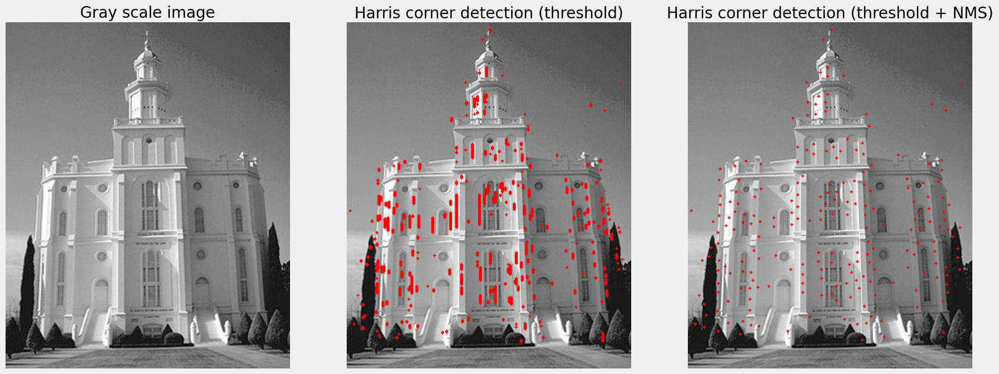

In [128]:
img = cv2.imread('../dataset/building.png')
k = 0.1
threshold = 10000
gray_img_corner = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY).astype(np.float32)
H, W = gray_img_corner.shape

gray_img_corner = cv2.GaussianBlur(gray_img_corner, (7, 7), 0.5, 0.5)
sobel_x = cv2.Sobel(gray_img_corner, cv2.CV_64F, 1, 0, ksize=3)  # Sobel filter in x direction
sobel_y = cv2.Sobel(gray_img_corner, cv2.CV_64F, 0, 1, ksize=3)  # Sobel filter in y direction
sobel_combined = cv2.magnitude(sobel_x, sobel_y)  # Combine the gradients

# Write your code here:
kernel = np.array([[-1,0,-1]])
operatedImage_ddx = apply_filter(sobel_combined, kernel)
operatedImage_ddy = apply_filter(sobel_combined, np.hstack(kernel), is1DVertical=True)
cornered_image_nms = harris_detection(img,operatedImage_ddx, operatedImage_ddy, k=k, threshold = threshold, nms=True)
cornered_image = harris_detection(img,operatedImage_ddx, operatedImage_ddy, k=k, threshold = threshold, nms=False)


# corners = cv2.cornerHarris(operatedImage,2,5,0.07)
# dest = cv2.dilate(corners, None)

# Reverting back to the original image, 
# with optimal threshold value 
# img[dest > 0.01 * dest.max()]=[255, 0, 0]

#harris_img_corner = draw_corners(img, corners)

fig, axis = plt.subplots(1, 3, figsize=(20, 8), sharey=False)
axis[0].imshow(gray_img, 'gray')
axis[0].grid(False)
axis[0].set_title('Gray scale image')
axis[0].set_axis_off()

axis[1].imshow(cornered_image, 'gray')
axis[1].grid(False)
axis[1].set_title('Harris corner detection (threshold)')
axis[1].set_axis_off()

axis[2].imshow(cornered_image_nms, 'gray')
axis[2].grid(False)
axis[2].set_title('Harris corner detection (threshold + NMS)')
axis[2].set_axis_off()


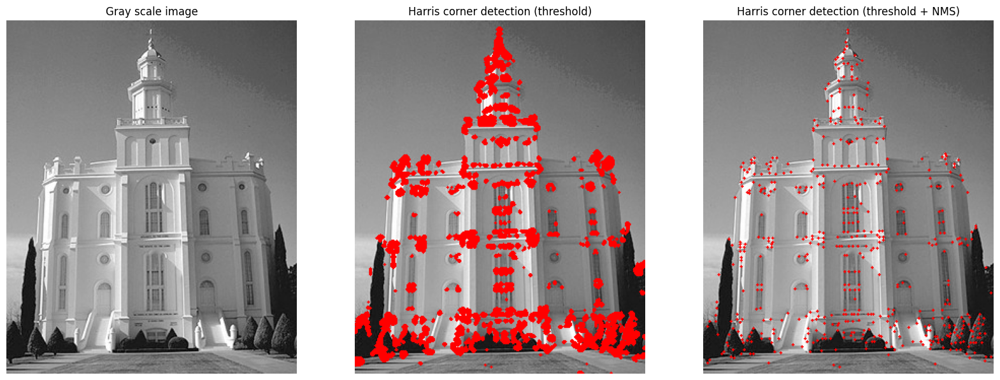

In [ ]:
'''
Did this on the cell above, this cell can be deleted
'''

# img = cv2.imread('../dataset/building.png')
# k = 0.05
# threshold = 2000.
# gray_img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY).astype(np.float32)
# H, W = gray_img.shape
# # Write your code here:
# 
# corners =
# harris_img_corner = draw_corners(img, corners)
# # corners after NMS
# corners_nms =
# harris_img_corner_nms = draw_corners(img, corners_nms)
# 
# # Show Original and detected corners on image
# fig, axis = plt.subplots(1, 3, figsize=(20, 8), sharey=False)
# axis[0].imshow(gray_img, 'gray')
# axis[0].grid(False)
# axis[0].set_title('Gray scale image')
# axis[0].set_axis_off()
# 
# axis[1].imshow(harris_img_corner, 'gray')
# axis[1].grid(False)
# axis[1].set_title('Harris corner detection (threshold)')
# axis[1].set_axis_off()
# 
# axis[2].imshow(harris_img_corner_nms, 'gray')
# axis[2].grid(False)
# axis[2].set_title('Harris corner detection (threshold + NMS)')
# axis[2].set_axis_off()
# 
# plt.show()

# Part 4 Feature extraction and Matching


## Task 8 SIFT Feature Detection and Matching

#### Step 1: SIFT Feature Detection and Visualization
Here we demonstrates how SIFT detects features in a single image:
- Loads and preprocesses the image
- Detects SIFT keypoints
- Visualizes the keypoints on the image
- Shows keypoint orientations and scales

#### Step 2: Feature Matching Between Images
Here we show how SIFT features are matched between two images:
- Detects features in both images
- Matches features using ratio test
- Visualizes the matching results with lines connecting matched points
- Shows match distance distribution

### Tasks:

1. With the example provided:
   1.  Vary the paratmeter on  'max_image_size', 'max_features', 'ratio_thresh' to see their impact on perforamnce, such as matching reuslt and time consumption.

2. Capture your own image pair with:
   1. Slight variation of angle and match them
   2. Big variation of angle and match them
   3. Different time of the day or lighting variation and match them
   4. With one image using your phone or laptop webcam and match them

3. Compare Harris detector result with SIFT and FAST (https://docs.opencv.org/3.4/df/d0c/tutorial_py_fast.html)


In [348]:
import cv2
import time
import numpy as np
import matplotlib.pyplot as plt

#### Common Functions

In [377]:
# Common Functions
def load_image(image_path, max_size):
    """Load and resize image if too large"""
    img = cv2.imread(image_path)
    if img is None:
        raise FileNotFoundError(f"Could not load image: {image_path}")
    
    # Resize if image is too large
    h, w = img.shape[:2]
    if max(h, w) > max_size:
        scale = max_size / max(h, w)
        new_size = (int(w * scale), int(h * scale))
        img = cv2.resize(img, new_size, interpolation=cv2.INTER_AREA)
    
    img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    img_gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    
    return img_gray, img_rgb

def visualize_features(img_rgb, keypoints, title="SIFT Features"):
    """Visualize SIFT features with circles and orientations"""
    img_with_kp = img_rgb.copy()
    
    for kp in keypoints:
        x, y = int(kp.pt[0]), int(kp.pt[1])
        size = int(kp.size)
        angle = kp.angle * np.pi / 180.0
        
        cv2.circle(img_with_kp, (x, y), size, (0, 255, 0), 1)
        end_x = int(x + size * np.cos(angle))
        end_y = int(y + size * np.sin(angle))
        cv2.line(img_with_kp, (x, y), (end_x, end_y), (0, 255, 0), 1)
    
    plt.figure(figsize=(12, 8))
    plt.imshow(img_with_kp)
    plt.title(f"{title}\n{len(keypoints)} keypoints detected")
    plt.axis('off')
    plt.tight_layout()

    
def visualize_matches(img1_rgb, img2_rgb, keypoints1, keypoints2, good_matches, 
                     distances, max_display_matches, suptitle=None, title="SIFT Matches"):
    """Visualize feature matches between images"""
    good_matches = sorted(good_matches, key=lambda x: x.distance)[:max_display_matches]
    
    plt.figure(figsize=(12, 6))
    if(suptitle is not None):
        plt.suptitle(suptitle)
    # Plot histogram
    plt.subplot(1, 2, 1)
    plt.hist(distances, bins=30, color='blue', alpha=0.7)
    plt.title(f"Match Distances\n({len(good_matches)} shown of {len(distances)} matches)")
    plt.xlabel("Distance")
    plt.ylabel("Count")
    
    # Draw matches
    match_img = cv2.drawMatches(
        img1_rgb, keypoints1,
        img2_rgb, keypoints2,
        good_matches, None,
        flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS,
        matchColor=(0, 255, 0)
    )
    
    plt.subplot(1, 2, 2)
    plt.imshow(match_img)
    plt.title(title)
    plt.axis('off')
    plt.tight_layout()


In [378]:
def detect_features(img, max_features):
    """Detect SIFT features"""
    sift = cv2.SIFT_create(nfeatures=max_features)
    keypoints, descriptors = sift.detectAndCompute(img, None)
    return keypoints, descriptors


In [379]:
def match_features(descriptors1, descriptors2, ratio_thresh):
    """Match features using BFMatcher with ratio test"""
    bf = cv2.BFMatcher(cv2.NORM_L2)
    matches = bf.knnMatch(descriptors1, descriptors2, k=2)
    
    good_matches = []
    distances = []
    for m, n in matches:
        if m.distance < ratio_thresh * n.distance:
            good_matches.append(m)
            distances.append(m.distance)
    
    return good_matches, distances

#### Extract Feature Points


=== Stage 1: Single Image SIFT Detection ===
Image size: (277, 400, 3)
Processing time: 0.354 seconds
Features detected: 1001
Image size: (415, 600, 3)
Processing time: 0.266 seconds
Features detected: 1000
Image size: (554, 800, 3)
Processing time: 0.400 seconds
Features detected: 1000
Image size: (692, 1000, 3)
Processing time: 0.500 seconds
Features detected: 1000


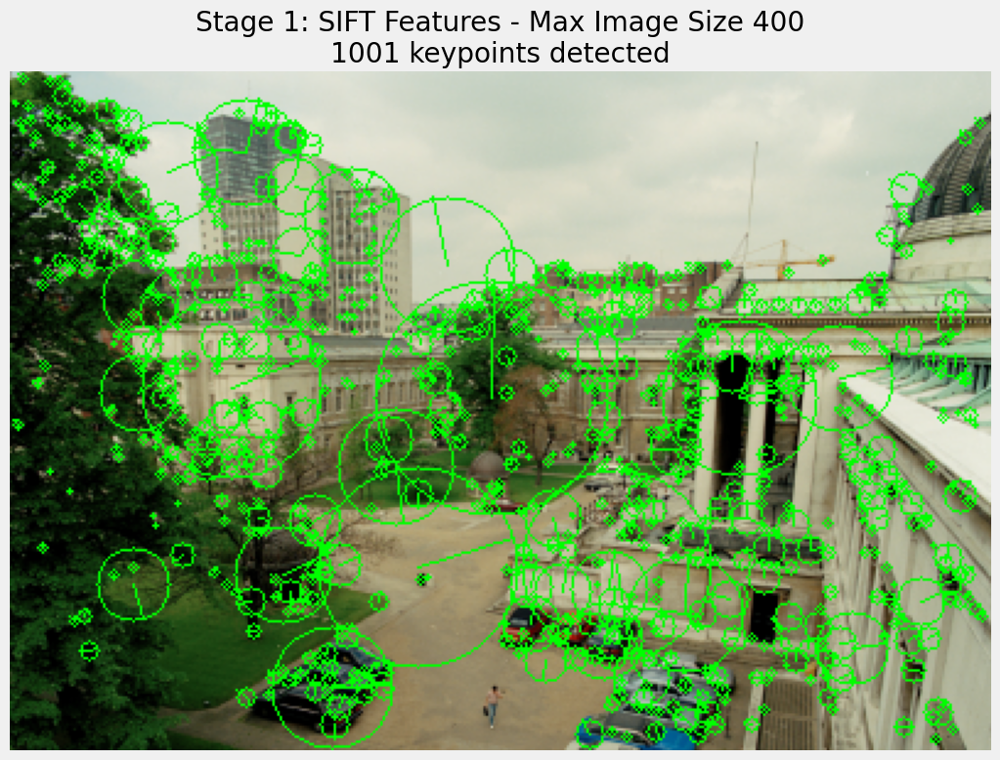

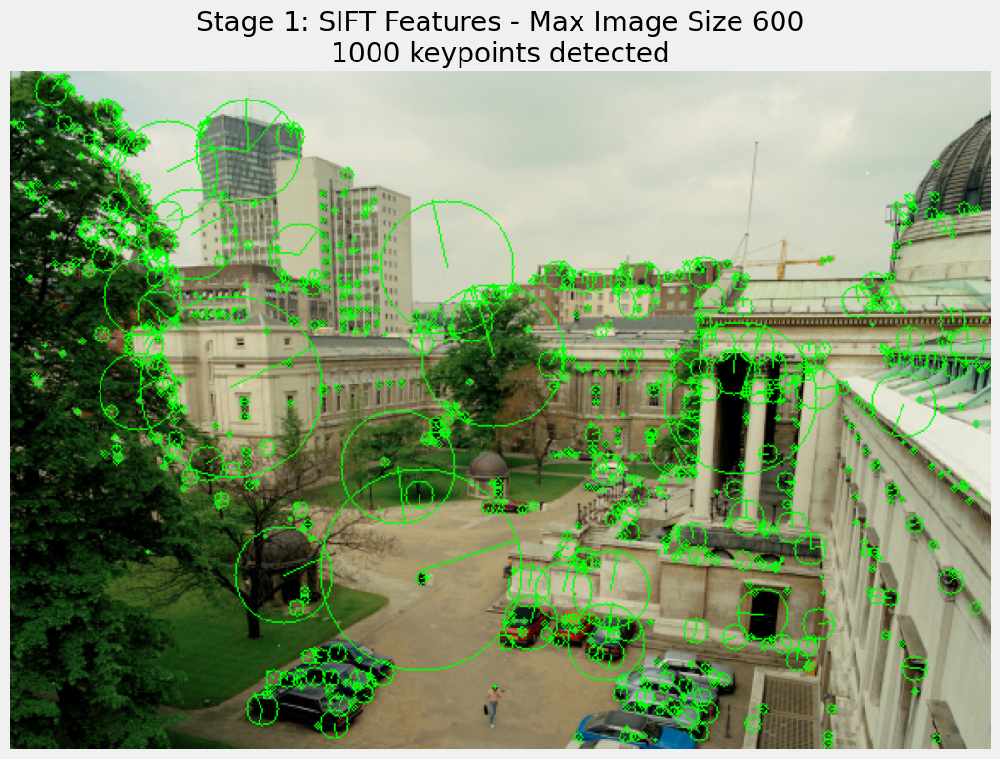

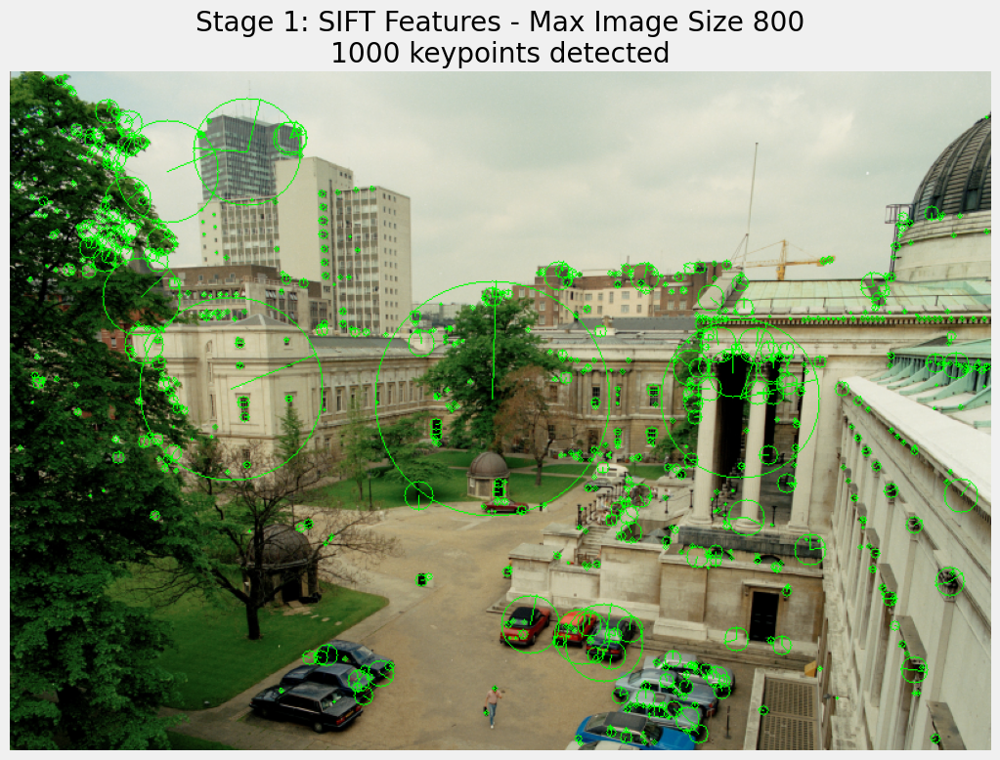

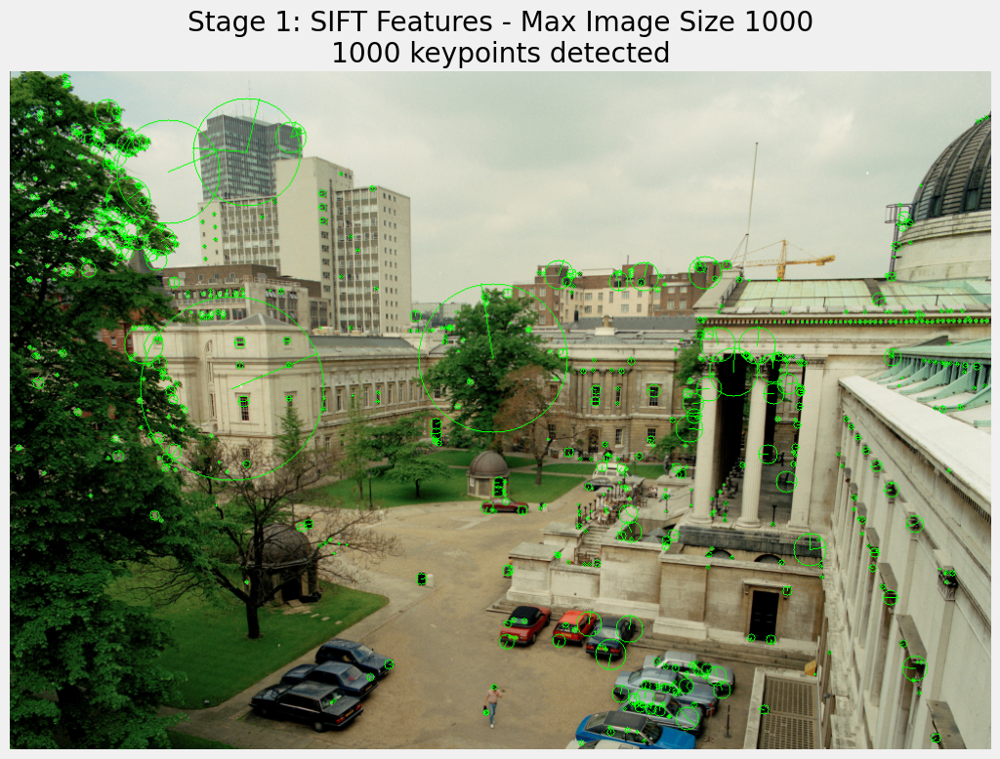

In [380]:
# Parameters for Stage 1
params = {
    'max_image_size': 400,
    'max_features': 1000,
}

# Image path
img_path = '../dataset/UCL_21May91.jpg'

print("\n=== Stage 1: Single Image SIFT Detection ===")

for x in range(4):
    # Load and process image
    t0 = time.time()
    img_gray, img_rgb = load_image(img_path, params['max_image_size'])
    print(f"Image size: {img_rgb.shape}")

    # Detect features
    keypoints, descriptors = detect_features(img_gray, params['max_features'])
    t1 = time.time()

    print(f"Processing time: {t1-t0:.3f} seconds")
    print(f"Features detected: {len(keypoints)}")

    # Visualize
    visualize_features(img_rgb, keypoints, f"Stage 1: SIFT Features - Max Image Size {params['max_image_size']}")
    params['max_image_size'] = params['max_image_size'] + 200
plt.show()

#### Match feature Points 


=== Stage 2: Feature Matching ===
Image 1 features: 601
Image 2 features: 600
Processing time: 0.533 seconds
Matches found: 13 good matches
Image 1 features: 800
Image 2 features: 801
Processing time: 0.720 seconds
Matches found: 50 good matches
Image 1 features: 1000
Image 2 features: 1001
Processing time: 0.864 seconds
Matches found: 100 good matches
Image 1 features: 1401
Image 2 features: 1401
Processing time: 1.193 seconds
Matches found: 427 good matches


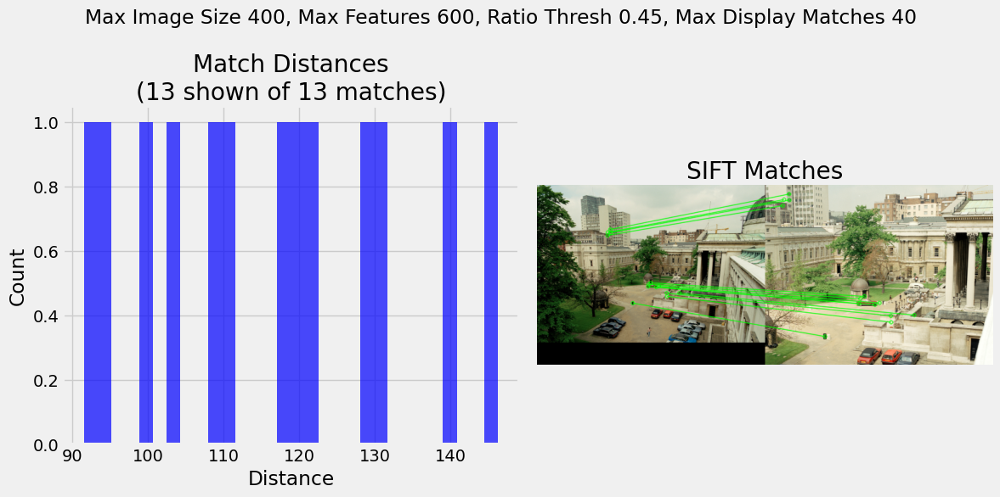

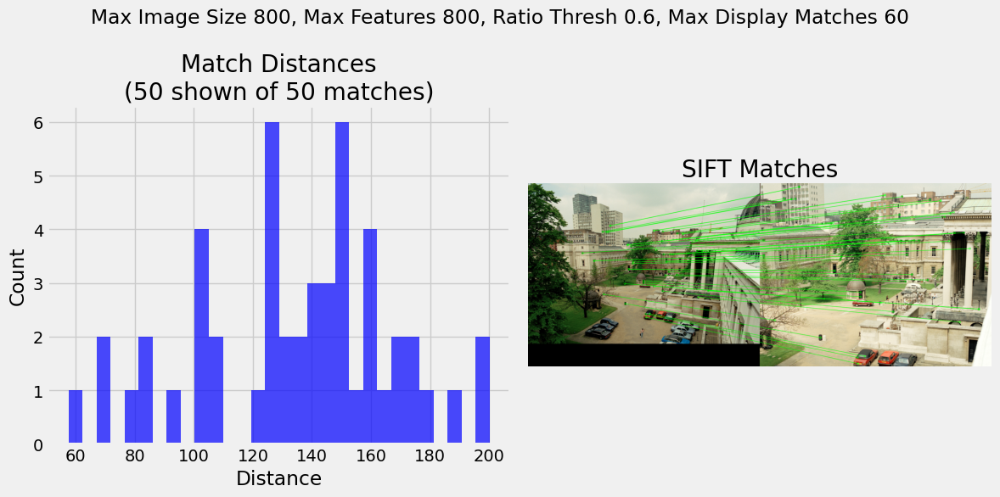

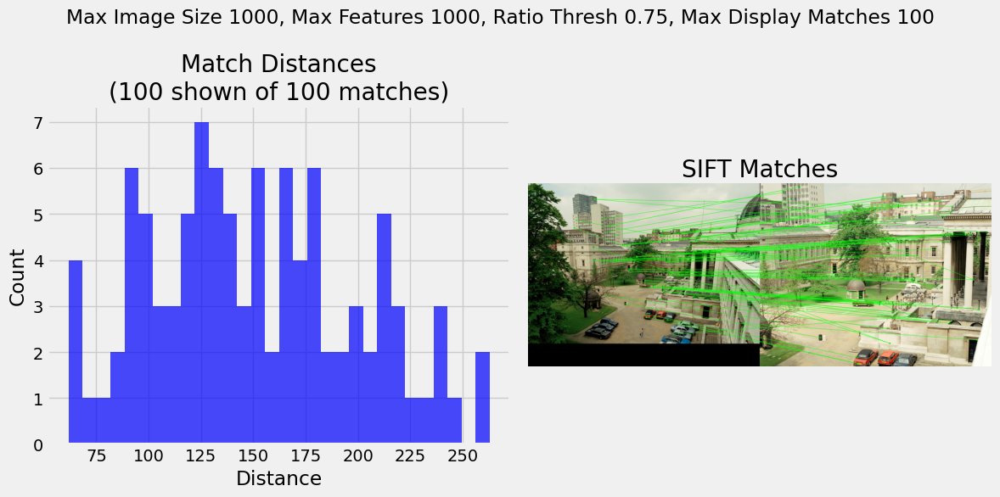

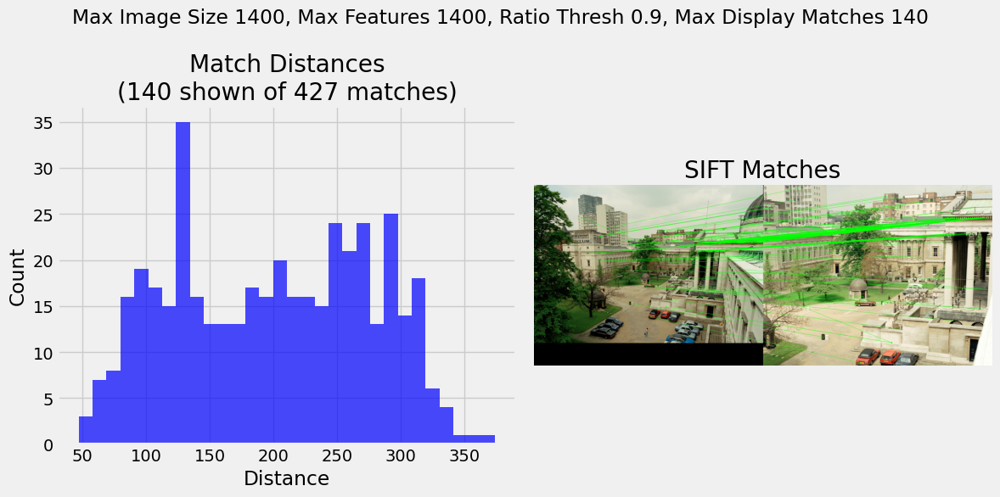

In [383]:
# Parameters for Stage 2
parameters = []
params1 = {
    'max_image_size': 400,
    'max_features': 600,
    'ratio_thresh': 0.45,
    'max_display_matches': 40
}
params2 = {
    'max_image_size': 800,
    'max_features': 800,
    'ratio_thresh': 0.6,
    'max_display_matches': 60
}
params3 = {
    'max_image_size': 1000,
    'max_features': 1000,
    'ratio_thresh': 0.75,
    'max_display_matches': 100
}
params4 = {
    'max_image_size': 1400,
    'max_features': 1400,
    'ratio_thresh': 0.9,
    'max_display_matches': 140
}
parameters.append(params1)
parameters.append(params2)
parameters.append(params3)
parameters.append(params4)

# Image paths
img1_path = '../dataset/UCL_21May91.jpg'
img2_path = '../dataset/UCLQuad_21May91.jpg'

print("\n=== Stage 2: Feature Matching ===")

# Load and process first image
for params in parameters:
    t0 = time.time()
    img1_gray, img1_rgb = load_image(img1_path, params['max_image_size'])
    keypoints1, descriptors1 = detect_features(img1_gray, params['max_features'])
    print(f"Image 1 features: {len(keypoints1)}")

    # Load and process second image
    img2_gray, img2_rgb = load_image(img2_path, params['max_image_size'])
    keypoints2, descriptors2 = detect_features(img2_gray, params['max_features'])
    print(f"Image 2 features: {len(keypoints2)}")

    # Match features
    good_matches, distances = match_features(descriptors1, descriptors2, 
                                        params['ratio_thresh'])
    t1 = time.time()

    print(f"Processing time: {t1-t0:.3f} seconds")
    print(f"Matches found: {len(good_matches)} good matches")

    # Visualize matches
    visualize_matches(img1_rgb, img2_rgb, keypoints1, keypoints2, 
                    good_matches, distances, params['max_display_matches'], suptitle=f"Max Image Size {params['max_image_size']}, Max Features {params['max_features']}, Ratio Thresh {params['ratio_thresh']}, Max Display Matches {params['max_display_matches']}")
plt.show()

Fast Implementation

In [342]:
def detect_features(img, threshold):
    """Detect FAST features"""
    fast = cv2.FastFeatureDetector_create(threshold=threshold)
    keypoints = fast.detect(img,None)
    # Initialize the BRIEF extractor
    brief = cv2.xfeatures2d.BriefDescriptorExtractor_create()

    # Compute descriptors using BRIEF
    keypoints, descriptors = brief.compute(img, keypoints)

    return keypoints, descriptors



=== Stage 1: Single Image FAST Detection ===
Image size: (554, 800, 3)
Processing time: 0.240 seconds
Features detected: 875


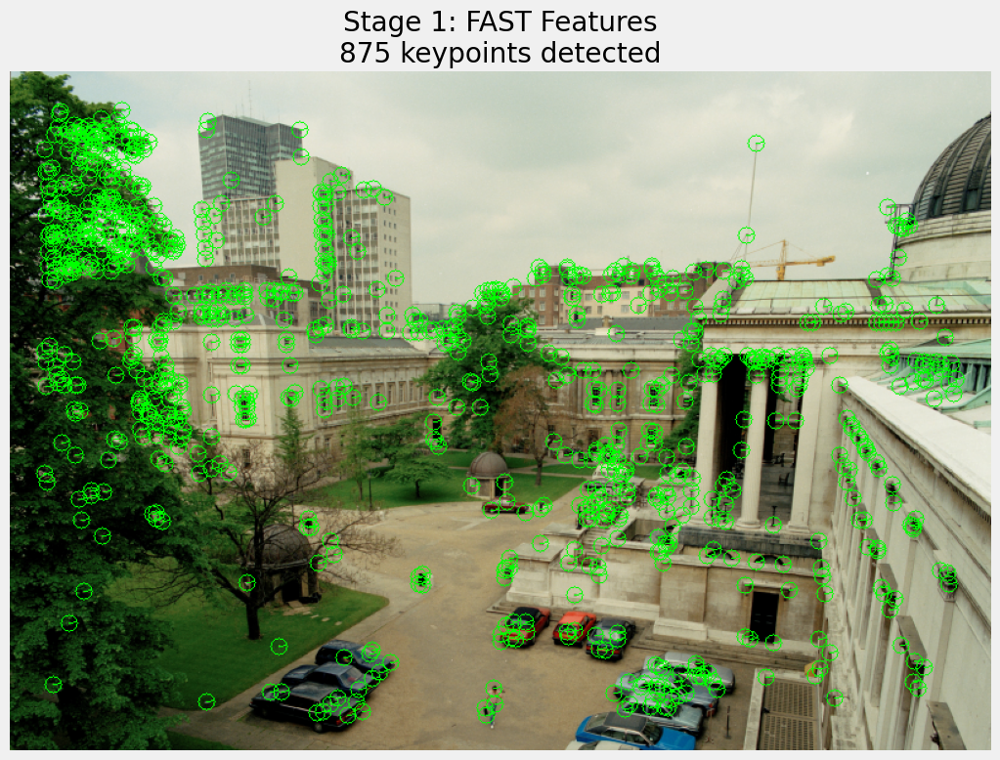

In [343]:
# Image path
img_path = '../dataset/UCL_21May91.jpg'

print("\n=== Stage 1: Single Image FAST Detection ===")

# Load and process image
t0 = time.time()
img_gray, img_rgb = load_image(img_path, params['max_image_size'])
print(f"Image size: {img_rgb.shape}")

# Detect features
keypoints, descriptors = detect_features(img_gray, threshold=70)
t1 = time.time()

print(f"Processing time: {t1-t0:.3f} seconds")
print(f"Features detected: {len(keypoints)}")

# Visualize
visualize_features(img_rgb, keypoints, "Stage 1: FAST Features")
plt.show()


=== Stage 2: Feature Matching ===
Image 1 features: 4276
Image 2 features: 4973
Processing time: 1.175 seconds
Matches found: 71 good matches


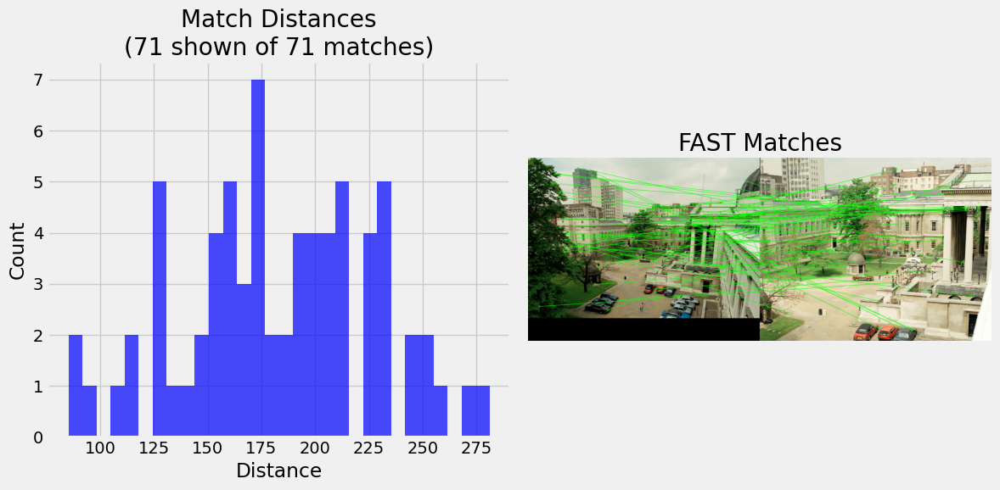

In [ ]:
# Parameters for Stage 2
params = {
    'max_image_size': 800,
    'max_features': 1000,
    'ratio_thresh': 0.75,
    'max_display_matches': 100
}
# Image paths
img1_path = '../dataset/UCL_21May91.jpg'
img2_path = '../dataset/UCLQuad_21May91.jpg'

print("\n=== Stage 2: Feature Matching ===")

threshold=30

t0 = time.time()
img1_gray, img1_rgb = load_image(img1_path, params['max_image_size'])
# Detect features
keypoints1, descriptors1 = detect_features(img1_gray, threshold=threshold)
print(f"Image 1 features: {len(keypoints1)}")
t1 = time.time()

# Load and process second image
img2_gray, img2_rgb = load_image(img2_path, params['max_image_size'])
keypoints2, descriptors2 = detect_features(img2_gray, threshold=threshold)
print(f"Image 2 features: {len(keypoints2)}")

# Match features
good_matches, distances = match_features(descriptors1, descriptors2, 
                                       params['ratio_thresh'])
t1 = time.time()

print(f"Processing time: {t1-t0:.3f} seconds")
print(f"Matches found: {len(good_matches)} good matches")

# Visualize matches
visualize_matches(img1_rgb, img2_rgb, keypoints1, keypoints2, 
                good_matches, distances, params['max_display_matches'], 'FAST Matches')
plt.show()